<a href="https://colab.research.google.com/github/Trongnhat191/Scene-Text-Recognition/blob/main/Text_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
cd /content/drive/MyDrive/Colab Notebooks/OCR

/content/drive/MyDrive/Colab Notebooks/OCR


###I. Prepare datasets

In [ ]:
import xml.etree.ElementTree as ET
import os


In [ ]:
def extract_data_from_xml(path):
    tree = ET.parse(path)
    root = tree.getroot()

    image_paths = []
    image_sizes = []
    image_labels = []
    bounding_boxes = []

    for image in root:
        bbs_of_image = []
        labels_of_image = []

        for bbs in image.findall('taggedRectangles'):
            for bb in bbs:
                #check if non-alphabet and non-number
                if not bb[0].text.isalnum():
                    continue

                if 'é' in bb[0].text.lower() or 'ñ' in bb[0].text.lower():
                    continue

                bbs_of_image.append([
                    float(bb.attrib['x']),
                    float(bb.attrib['y']),
                    float(bb.attrib['width']),
                    float(bb.attrib['height'])
                ])
                labels_of_image.append(bb[0].text.lower())

        image_paths.append(image[0].text)
        image_sizes.append((int(image[1].attrib['x']), int(image[1].attrib['y'])))
        bounding_boxes.append(bbs_of_image)
        image_labels.append(labels_of_image)

    return image_paths, image_sizes, image_labels, bounding_boxes

In [ ]:
words_xml_path = os.path.join('datasets','SceneTrialTrain', 'words.xml')
image_paths, image_sizes, image_labels, bounding_boxes = extract_data_from_xml(words_xml_path)

In [ ]:
import os
import shutil
import yaml
from sklearn.model_selection import train_test_split

In [ ]:
def convert_to_yolo_format(image_paths, image_sizes, bounding_boxes):
    yolo_data = []

    for image_path, image_size, bboxes in zip(image_paths, image_sizes, bounding_boxes):
        image_width, image_height = image_size

        yolo_labels = []

        for bbox in bboxes:
            x, y, w, h = bbox

            #normalize bouding box
            center_x = (x + w/2) / image_width
            center_y = (y + h/2) / image_height
            normalized_width = w / image_width
            normalized_height = h / image_height

            class_id = 0

            yolo_label = f"{class_id} {center_x} {center_y} {normalized_width} {normalized_height}"
            yolo_labels.append(yolo_label)

        yolo_data.append((image_path, yolo_labels))
    return yolo_data

In [ ]:
#define class labels
class_labels = ['text']

#convert to yolo format
yolo_data = convert_to_yolo_format(image_paths, image_sizes, bounding_boxes)

In [ ]:
yolo_data[0]

('apanar_06.08.2002/IMG_1261.JPG',
 ['0 0.194375 0.40791666666666665 0.17125 0.1625',
  '0 0.5321875 0.40208333333333335 0.424375 0.1525',
  '0 0.309375 0.5825 0.38875 0.145',
  '0 0.67875 0.5770833333333333 0.27875 0.15583333333333332',
  '0 0.0746875 0.04125 0.059375 0.0725',
  '0 0.2159375 0.03833333333333333 0.123125 0.07333333333333333',
  '0 0.5309375 0.03375 0.071875 0.0675',
  '0 0.19625 0.7645833333333333 0.1425 0.11583333333333333',
  '0 0.3471875 0.7770833333333333 0.103125 0.09083333333333334',
  '0 0.4496875 0.7758333333333334 0.044375 0.08833333333333333',
  '0 0.571875 0.7620833333333333 0.13625 0.1175'])

In [ ]:
seed = 0
val_size = 0.2
test_size = 0.125
is_shuffle = True
train_data, test_data = train_test_split(yolo_data, test_size=val_size, random_state=seed, shuffle=is_shuffle)
train_data, val_data = train_test_split(train_data, test_size=test_size, random_state=seed, shuffle=is_shuffle)

In [ ]:
def save_data(data, src_img_dir, save_dir):
    #Create foler if not exist
    os.makedirs(save_dir, exist_ok=True)

    #make images and labels folder
    os.makedirs(os.path.join(save_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(save_dir, 'labels'), exist_ok=True)

    for image_path, yolo_labels in data:
        #copy images to images folder
        shutil.copy(
            os.path.join(src_img_dir, image_path),
            os.path.join(save_dir, 'images')
        )

        #save labels to labels folder
        image_name = os.path.basename(image_path)
        image_name = os.path.splitext(image_name)[0]

        with open(os.path.join(save_dir, 'labels', f'{image_name}.txt'), 'w') as f:
            for yolo_label in yolo_labels:
                f.write(yolo_label + '\n')

In [ ]:
dataset_dir = 'datasets/SceneTrialTrain'

In [ ]:
save_yolo_data_dir = 'datasets/yolo_data'
os.makedirs(save_yolo_data_dir, exist_ok=True)

save_train_dir = os.path.join(
    save_yolo_data_dir, 'train'
)
save_val_dir = os.path.join(
    save_yolo_data_dir, 'val'
)
save_test_dir = os.path.join(
    save_yolo_data_dir, 'test'
)



In [ ]:
save_data(
    train_data,
    dataset_dir,
    save_train_dir
)
save_data(
    val_data,
    dataset_dir,
    save_test_dir
)
save_data(
    test_data,
    dataset_dir,
    save_val_dir
)

In [ ]:
data_yaml = {
    'path': 'yolo_data',
    'train': 'train/images',
    'test': 'test/images',
    'val': 'val/images',
    'nc': 1,
    'names': class_labels
}

yolo_yaml_path = os.path.join(
    save_yolo_data_dir, 'data.yaml'
)

with open(yolo_yaml_path, 'w') as f:
    yaml.dump(data_yaml, f, default_flow_style=False)

In [ ]:
!pip  install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 886.3/886.3 kB 15.6 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
model = YOLO('yolov8s.yaml').load('yolov8s.pt')

100%|██████████| 21.5M/21.5M [00:00<00:00, 158MB/s]


Transferred 355/355 items from pretrained weights


In [ ]:
epochs = 200
imgsz = 1024
results = model.train(
    data = yolo_yaml_path,
    epochs = epochs,
    imgsz = imgsz,
    project = 'models',
    name = 'yolov8/detect/train'
)

Ultralytics 8.3.31 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=datasets/yolo_data/data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=1024, save=True, save_period=-1, cache=False, device=None, workers=8, project=models, name=train, exist_ok=False, pretrained=yolov8s.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=Tr

100%|██████████| 755k/755k [00:00<00:00, 36.2MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 131MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/Colab Notebooks/OCR/datasets/yolo_data/train/labels... 175 images, 5 backgrounds, 0 corrupt: 100%|██████████| 175/175 [00:02<00:00, 84.49it/s]


train: New cache created: /content/drive/MyDrive/Colab Notebooks/OCR/datasets/yolo_data/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/drive/MyDrive/Colab Notebooks/OCR/datasets/yolo_data/val/labels... 50 images, 2 backgrounds, 0 corrupt: 100%|██████████| 50/50 [00:01<00:00, 42.82it/s]


val: New cache created: /content/drive/MyDrive/Colab Notebooks/OCR/datasets/yolo_data/val/labels.cache
Plotting labels to models/yolov8/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 1024 train, 1024 val
Using 2 dataloader workers
Logging results to models/yolov8/detect/train
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/200      9.42G      2.139      5.854      1.895         89       1024: 100%|██████████| 11/11 [00:11<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]

                   all         50        262       0.37      0.313      0.281      0.141



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/200      9.29G      1.104      1.785      1.173        142       1024: 100%|██████████| 11/11 [00:07<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.14s/it]


                   all         50        262      0.657      0.679      0.655      0.427

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/200      9.29G      1.048      1.399      1.136        110       1024: 100%|██████████| 11/11 [00:07<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         50        262      0.729      0.638      0.678      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/200      9.13G      1.076      1.262      1.124        112       1024: 100%|██████████| 11/11 [00:09<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]

                   all         50        262      0.587       0.66      0.623      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/200      9.37G      1.116       1.28      1.159        156       1024: 100%|██████████| 11/11 [00:07<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all         50        262      0.053      0.794     0.0512     0.0307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/200      9.41G      1.082      1.139      1.137        124       1024: 100%|██████████| 11/11 [00:06<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]

                   all         50        262      0.597      0.634      0.652      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/200      9.07G      1.112      1.066      1.148        146       1024: 100%|██████████| 11/11 [00:09<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.52it/s]

                   all         50        262      0.463      0.653      0.455      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/200       9.3G      1.172      1.143       1.18         78       1024: 100%|██████████| 11/11 [00:06<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.04it/s]

                   all         50        262       0.34      0.715      0.361      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/200      9.12G      1.098      1.035      1.157        139       1024: 100%|██████████| 11/11 [00:08<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.81it/s]

                   all         50        262      0.485      0.569      0.483      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/200      9.14G      1.148      1.085      1.177        121       1024: 100%|██████████| 11/11 [00:07<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.05s/it]

                   all         50        262      0.289      0.401      0.272      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/200      9.18G      1.197      1.021      1.169        194       1024: 100%|██████████| 11/11 [00:06<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         50        262      0.349      0.351      0.273      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/200      9.35G      1.074       0.98      1.148         93       1024: 100%|██████████| 11/11 [00:10<00:00,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         50        262      0.316      0.485      0.275      0.137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/200      9.34G      1.086     0.9947      1.158         96       1024: 100%|██████████| 11/11 [00:06<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         50        262      0.211      0.378      0.149     0.0706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/200      9.24G      1.069     0.9814      1.137         85       1024: 100%|██████████| 11/11 [00:07<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         50        262       0.33      0.353      0.288      0.141



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/200      9.34G       1.09     0.9308      1.149        133       1024: 100%|██████████| 11/11 [00:07<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.13s/it]

                   all         50        262      0.493      0.508      0.457      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/200      9.36G      1.061     0.8821      1.121        112       1024: 100%|██████████| 11/11 [00:07<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.39s/it]

                   all         50        262       0.66      0.649      0.674      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/200      9.32G      1.037     0.8434      1.092        116       1024: 100%|██████████| 11/11 [00:09<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         50        262      0.681      0.659      0.677      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/200      9.12G      1.055     0.8535      1.117        101       1024: 100%|██████████| 11/11 [00:07<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.73s/it]

                   all         50        262      0.672      0.748      0.743      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/200      9.22G      1.055     0.8752      1.145        118       1024: 100%|██████████| 11/11 [00:07<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         50        262      0.638      0.653      0.649      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/200      9.39G       1.07     0.8902      1.151        113       1024: 100%|██████████| 11/11 [00:09<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.63it/s]

                   all         50        262      0.732      0.683       0.73      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/200       9.1G      1.064     0.8793      1.117        148       1024: 100%|██████████| 11/11 [00:07<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.13it/s]

                   all         50        262      0.843      0.553      0.628      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/200      9.33G      0.977     0.8095      1.089         86       1024: 100%|██████████| 11/11 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         50        262      0.764      0.756      0.789      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/200      9.29G     0.9686      0.778       1.08        137       1024: 100%|██████████| 11/11 [00:09<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.31it/s]

                   all         50        262      0.777      0.813       0.84      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/200      9.18G      1.007     0.8229      1.094         90       1024: 100%|██████████| 11/11 [00:07<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.09s/it]

                   all         50        262      0.747      0.725      0.776       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/200       9.1G     0.9721      0.788      1.084        124       1024: 100%|██████████| 11/11 [00:07<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         50        262      0.755      0.786      0.784      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/200       9.3G     0.9926     0.7888      1.108        143       1024: 100%|██████████| 11/11 [00:10<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.23s/it]

                   all         50        262      0.674      0.744      0.684      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/200      9.15G     0.9772     0.7573      1.062        192       1024: 100%|██████████| 11/11 [00:08<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all         50        262      0.776      0.817      0.818      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/200      9.35G     0.9675     0.7607      1.075        121       1024: 100%|██████████| 11/11 [00:06<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         50        262      0.768       0.79      0.813      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/200      9.28G     0.9615      0.738      1.084        124       1024: 100%|██████████| 11/11 [00:09<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         50        262      0.755      0.737       0.76      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/200      9.13G     0.9731     0.7679      1.069        129       1024: 100%|██████████| 11/11 [00:06<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all         50        262      0.824      0.763      0.836      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/200      9.33G     0.9775     0.7588      1.092         85       1024: 100%|██████████| 11/11 [00:07<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.58it/s]

                   all         50        262      0.828      0.802      0.846      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/200      9.48G     0.9497     0.7117      1.052        108       1024: 100%|██████████| 11/11 [00:09<00:00,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.23it/s]

                   all         50        262      0.793      0.876      0.857      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/200      9.29G     0.9205     0.7191      1.052        133       1024: 100%|██████████| 11/11 [00:09<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.11it/s]

                   all         50        262      0.767      0.809      0.806      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/200       9.3G     0.9112     0.7132      1.057         89       1024: 100%|██████████| 11/11 [00:07<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         50        262       0.82      0.836      0.869      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/200      9.29G     0.8739     0.6879      1.038        120       1024: 100%|██████████| 11/11 [00:08<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         50        262      0.807      0.812      0.836      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/200      9.17G     0.9069     0.7092      1.047        103       1024: 100%|██████████| 11/11 [00:09<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all         50        262      0.849      0.844      0.876      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/200      9.32G     0.9026     0.7233      1.034        113       1024: 100%|██████████| 11/11 [00:07<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.70it/s]

                   all         50        262      0.837       0.79      0.853        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/200      9.11G     0.8961     0.6893      1.036        126       1024: 100%|██████████| 11/11 [00:08<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.04s/it]

                   all         50        262      0.772      0.828      0.863      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/200      9.22G     0.8694     0.6876      1.039         73       1024: 100%|██████████| 11/11 [00:06<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.05it/s]

                   all         50        262      0.763      0.832      0.821      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/200      9.15G     0.8728     0.6322      1.019        144       1024: 100%|██████████| 11/11 [00:08<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         50        262      0.838      0.892      0.884      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/200      9.24G     0.8918     0.6643       1.02        128       1024: 100%|██████████| 11/11 [00:14<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         50        262      0.786      0.866      0.855      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/200      9.23G     0.8478     0.6425      1.016        129       1024: 100%|██████████| 11/11 [00:07<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.33s/it]

                   all         50        262      0.811      0.819      0.847       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/200      9.13G     0.9176     0.6757      1.052        121       1024: 100%|██████████| 11/11 [00:10<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.00it/s]

                   all         50        262      0.826      0.849      0.865      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/200      9.36G       0.88     0.6364      1.018        102       1024: 100%|██████████| 11/11 [00:09<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.53it/s]

                   all         50        262      0.798      0.878      0.846      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/200      9.28G     0.8406     0.5859      0.989        111       1024: 100%|██████████| 11/11 [00:08<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         50        262      0.766      0.859       0.83      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/200      9.32G     0.8218     0.6259      1.019        133       1024: 100%|██████████| 11/11 [00:07<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.23it/s]

                   all         50        262      0.784      0.824       0.82      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/200      9.11G     0.8373     0.6071      1.002        114       1024: 100%|██████████| 11/11 [00:07<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.34it/s]

                   all         50        262      0.844      0.844      0.874      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/200      9.36G     0.8107     0.6079     0.9953        107       1024: 100%|██████████| 11/11 [00:10<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.67it/s]

                   all         50        262       0.84      0.836      0.859      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/200      9.27G     0.8013      0.608      0.994        104       1024: 100%|██████████| 11/11 [00:06<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.13it/s]

                   all         50        262      0.861      0.855      0.879      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/200      9.14G     0.8027     0.6197      1.009        125       1024: 100%|██████████| 11/11 [00:08<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.62it/s]

                   all         50        262      0.828      0.855      0.881       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/200      9.31G     0.8034     0.5944      1.006        151       1024: 100%|██████████| 11/11 [00:07<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.17s/it]

                   all         50        262      0.862      0.762      0.845      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/200      9.35G     0.8433     0.6153      1.006        153       1024: 100%|██████████| 11/11 [00:06<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.63it/s]

                   all         50        262      0.873      0.817      0.892      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/200      9.22G      0.799     0.5905      0.987        184       1024: 100%|██████████| 11/11 [00:11<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.02it/s]

                   all         50        262      0.827      0.805      0.853      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/200      9.36G     0.7973     0.6017     0.9929        135       1024: 100%|██████████| 11/11 [00:07<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]

                   all         50        262      0.836      0.836      0.882      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/200      9.51G      0.815     0.5853      1.011        158       1024: 100%|██████████| 11/11 [00:07<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.76it/s]

                   all         50        262      0.812      0.855       0.88       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/200      9.41G     0.7877     0.6023     0.9786        127       1024: 100%|██████████| 11/11 [00:09<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.43s/it]

                   all         50        262       0.77      0.866      0.853      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/200      9.29G     0.8742     0.6679      1.025        164       1024: 100%|██████████| 11/11 [00:06<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         50        262      0.857      0.813      0.845      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/200      9.31G     0.8164     0.6042     0.9973        183       1024: 100%|██████████| 11/11 [00:09<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.68it/s]

                   all         50        262      0.831      0.813      0.864      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/200       9.3G     0.7963     0.5594     0.9729        139       1024: 100%|██████████| 11/11 [00:07<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.10s/it]

                   all         50        262      0.847      0.844      0.879      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/200       9.4G     0.7865     0.5782      1.003        110       1024: 100%|██████████| 11/11 [00:07<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.61it/s]

                   all         50        262      0.878      0.821      0.885      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/200      9.12G     0.7964     0.5581     0.9977        183       1024: 100%|██████████| 11/11 [00:08<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.05it/s]

                   all         50        262      0.846      0.851      0.904      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/200       9.1G     0.7806      0.572     0.9735        133       1024: 100%|██████████| 11/11 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         50        262      0.885      0.859      0.907      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/200      9.28G     0.7632     0.5661     0.9976        122       1024: 100%|██████████| 11/11 [00:08<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]

                   all         50        262      0.862      0.859      0.906      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/200      9.27G     0.7896     0.5504     0.9839        109       1024: 100%|██████████| 11/11 [00:08<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.08s/it]

                   all         50        262      0.837       0.88      0.896      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/200      9.14G     0.7666     0.5415     0.9977         80       1024: 100%|██████████| 11/11 [00:06<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         50        262      0.833      0.908      0.873      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/200      9.35G     0.7478     0.5463     0.9658         83       1024: 100%|██████████| 11/11 [00:10<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.51it/s]

                   all         50        262      0.874      0.901      0.894      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/200      9.24G     0.7558     0.5539     0.9907        125       1024: 100%|██████████| 11/11 [00:09<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.20s/it]

                   all         50        262      0.903      0.889      0.928       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/200      9.16G     0.7493     0.5361     0.9948        110       1024: 100%|██████████| 11/11 [00:06<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all         50        262        0.9      0.874      0.912      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/200      9.07G     0.7772     0.5435     0.9931        131       1024: 100%|██████████| 11/11 [00:10<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         50        262       0.87      0.871      0.907      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/200      9.24G       0.73     0.5259     0.9782        129       1024: 100%|██████████| 11/11 [00:08<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.35s/it]

                   all         50        262      0.894      0.836      0.892      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/200       9.3G      0.738     0.5309     0.9818         98       1024: 100%|██████████| 11/11 [00:07<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]

                   all         50        262      0.891      0.842      0.905      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/200      9.33G     0.7005     0.5321      0.954        122       1024: 100%|██████████| 11/11 [00:09<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         50        262      0.878      0.848      0.888      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/200      9.31G     0.7094     0.5203     0.9662        118       1024: 100%|██████████| 11/11 [00:06<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.08it/s]

                   all         50        262      0.885      0.863       0.89      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/200       9.3G     0.7403     0.5205     0.9547        118       1024: 100%|██████████| 11/11 [00:09<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         50        262      0.884      0.805      0.877      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/200      9.28G     0.7262     0.5492     0.9762        170       1024: 100%|██████████| 11/11 [00:10<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.04it/s]

                   all         50        262      0.831       0.88      0.869      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/200      9.29G     0.7391     0.5461     0.9618        124       1024: 100%|██████████| 11/11 [00:09<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.47s/it]

                   all         50        262      0.849       0.87      0.894      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/200      9.32G     0.7127     0.5248     0.9603         82       1024: 100%|██████████| 11/11 [00:08<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]

                   all         50        262      0.892       0.88      0.919      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/200      9.43G     0.7564     0.5245     0.9703        128       1024: 100%|██████████| 11/11 [00:08<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.13it/s]

                   all         50        262      0.875       0.88      0.904      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/200      9.29G     0.7591     0.5409     0.9876        102       1024: 100%|██████████| 11/11 [00:08<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.18s/it]

                   all         50        262      0.866      0.836      0.881      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/200      9.34G      0.714     0.5125     0.9639        121       1024: 100%|██████████| 11/11 [00:08<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.73it/s]

                   all         50        262       0.85      0.847      0.891      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/200      9.07G     0.7141     0.5224     0.9617        107       1024: 100%|██████████| 11/11 [00:07<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.30it/s]

                   all         50        262      0.822      0.863      0.881       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/200      9.17G     0.7448     0.5303     0.9692         95       1024: 100%|██████████| 11/11 [00:09<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         50        262      0.843      0.878      0.884      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/200      9.33G     0.7288     0.5082     0.9665        112       1024: 100%|██████████| 11/11 [00:09<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.52it/s]

                   all         50        262      0.878      0.851      0.893      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/200      9.33G      0.726     0.5521      0.966        151       1024: 100%|██████████| 11/11 [00:07<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all         50        262      0.866       0.87      0.892       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/200      9.35G     0.6955     0.4862     0.9564         87       1024: 100%|██████████| 11/11 [00:09<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all         50        262      0.858      0.874      0.908      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/200      9.34G     0.7044     0.4804     0.9576         65       1024: 100%|██████████| 11/11 [00:09<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.03it/s]

                   all         50        262      0.858      0.876      0.917      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/200      9.34G     0.6965     0.5127     0.9609         70       1024: 100%|██████████| 11/11 [00:06<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.46it/s]

                   all         50        262      0.881      0.821        0.9      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/200      9.19G     0.6867      0.482     0.9317        177       1024: 100%|██████████| 11/11 [00:09<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         50        262      0.899       0.85      0.919       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/200      9.14G     0.6769     0.4793     0.9377        165       1024: 100%|██████████| 11/11 [00:07<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.04it/s]

                   all         50        262      0.895      0.863      0.934      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/200      9.43G     0.6717      0.462     0.9308        140       1024: 100%|██████████| 11/11 [00:06<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]

                   all         50        262       0.89      0.835      0.915      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/200      9.28G     0.7074     0.4823     0.9518        116       1024: 100%|██████████| 11/11 [00:09<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all         50        262      0.885      0.828      0.887      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/200      9.21G      0.687     0.4712      0.948         80       1024: 100%|██████████| 11/11 [00:06<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         50        262      0.881      0.832      0.886      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/200      9.21G     0.6901     0.4823     0.9399        107       1024: 100%|██████████| 11/11 [00:08<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.65it/s]

                   all         50        262      0.811      0.868      0.883      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/200      9.28G     0.6845     0.4789      0.959         78       1024: 100%|██████████| 11/11 [00:07<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all         50        262      0.885      0.863      0.896      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/200      9.29G     0.6931     0.4807     0.9389        127       1024: 100%|██████████| 11/11 [00:06<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.43it/s]

                   all         50        262      0.912      0.836      0.916      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/200      9.37G     0.6617     0.4637     0.9403         69       1024: 100%|██████████| 11/11 [00:09<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]

                   all         50        262      0.894      0.847      0.916      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/200      9.11G     0.6783     0.4646     0.9295        132       1024: 100%|██████████| 11/11 [00:07<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all         50        262      0.836      0.895      0.914      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/200      9.36G     0.6903     0.4605     0.9496         97       1024: 100%|██████████| 11/11 [00:07<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         50        262      0.876      0.836      0.901      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/200      9.31G     0.6654      0.453     0.9529        108       1024: 100%|██████████| 11/11 [00:08<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.00it/s]

                   all         50        262      0.848      0.874      0.909      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/200      9.36G     0.6528     0.4612     0.9515         72       1024: 100%|██████████| 11/11 [00:06<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         50        262      0.878      0.878      0.909      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/200      9.32G     0.6466     0.4687     0.9366        161       1024: 100%|██████████| 11/11 [00:09<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.54it/s]

                   all         50        262      0.871      0.873      0.908      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/200       9.3G     0.6388     0.4469     0.9273        127       1024: 100%|██████████| 11/11 [00:07<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all         50        262      0.845      0.855      0.892      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/200      9.32G       0.68     0.4545     0.9446         92       1024: 100%|██████████| 11/11 [00:07<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         50        262       0.88      0.894      0.924      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/200      9.19G     0.6891     0.4763     0.9436        146       1024: 100%|██████████| 11/11 [00:09<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         50        262      0.874      0.901      0.905      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/200      9.11G     0.6407     0.4563     0.9103        156       1024: 100%|██████████| 11/11 [00:06<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.67it/s]

                   all         50        262      0.865      0.905      0.913       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/200      9.13G     0.6213     0.4369     0.9343        110       1024: 100%|██████████| 11/11 [00:08<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.55it/s]

                   all         50        262      0.884      0.897      0.917      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/200      9.32G     0.6405     0.4484     0.9272         97       1024: 100%|██████████| 11/11 [00:08<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.03s/it]

                   all         50        262      0.907      0.852      0.924      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/200      9.35G     0.6392     0.4264     0.9218        104       1024: 100%|██████████| 11/11 [00:07<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all         50        262      0.823      0.878      0.903      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/200      9.32G     0.6108     0.4225     0.9312         95       1024: 100%|██████████| 11/11 [00:08<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         50        262      0.861      0.874      0.904      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/200      9.07G     0.6483     0.4381     0.9228        135       1024: 100%|██████████| 11/11 [00:07<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.10s/it]

                   all         50        262      0.905      0.878      0.913      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/200      9.29G     0.6152     0.4317     0.9256        110       1024: 100%|██████████| 11/11 [00:06<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.65it/s]

                   all         50        262      0.871       0.87      0.909      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/200      9.18G      0.619      0.423     0.9248        202       1024: 100%|██████████| 11/11 [00:09<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         50        262       0.88      0.885      0.918      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/200      9.31G     0.6432     0.4231     0.9198        103       1024: 100%|██████████| 11/11 [00:06<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.13it/s]

                   all         50        262      0.886      0.889      0.927      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/200      9.24G     0.6272     0.4223     0.9381         73       1024: 100%|██████████| 11/11 [00:08<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         50        262      0.889      0.889      0.927      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/200      9.28G     0.5996     0.4206     0.9052        105       1024: 100%|██████████| 11/11 [00:08<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.07s/it]

                   all         50        262      0.908      0.901      0.938      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/200      9.36G     0.6027     0.4146     0.9092         83       1024: 100%|██████████| 11/11 [00:08<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.14it/s]

                   all         50        262      0.888      0.912      0.943      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/200      9.34G     0.6162     0.4204     0.9172        146       1024: 100%|██████████| 11/11 [00:08<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         50        262      0.931      0.874      0.936      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/200      9.23G     0.6337     0.4254     0.9123        108       1024: 100%|██████████| 11/11 [00:08<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.05it/s]

                   all         50        262      0.912      0.889      0.931      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/200       9.3G     0.6132     0.4222     0.9258         92       1024: 100%|██████████| 11/11 [00:07<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         50        262      0.889      0.917      0.942      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/200      9.12G     0.6096     0.4215     0.9124         80       1024: 100%|██████████| 11/11 [00:09<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.65it/s]

                   all         50        262      0.891      0.909      0.933        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/200      9.23G     0.5838     0.4118     0.9244        141       1024: 100%|██████████| 11/11 [00:07<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.09s/it]

                   all         50        262      0.917      0.883      0.918      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/200      9.23G     0.5947     0.4086     0.9142        116       1024: 100%|██████████| 11/11 [00:09<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.02s/it]

                   all         50        262      0.892      0.908      0.907      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/200      9.23G      0.595     0.4123     0.9181        100       1024: 100%|██████████| 11/11 [00:10<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         50        262      0.886      0.886      0.899      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/200      9.28G     0.5824     0.4026     0.9112        103       1024: 100%|██████████| 11/11 [00:08<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]

                   all         50        262      0.859       0.91      0.918      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/200      9.27G        0.6     0.4071     0.9257         87       1024: 100%|██████████| 11/11 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.53it/s]

                   all         50        262      0.869      0.908      0.928      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/200      9.07G     0.5942     0.4099     0.9184         70       1024: 100%|██████████| 11/11 [00:08<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all         50        262      0.881      0.916      0.931       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/200      9.34G     0.5855     0.3975     0.8931         91       1024: 100%|██████████| 11/11 [00:06<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.58it/s]

                   all         50        262      0.877      0.927      0.935      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/200      9.37G      0.569      0.388     0.8942        108       1024: 100%|██████████| 11/11 [00:09<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.58it/s]

                   all         50        262      0.906      0.889      0.934      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/200      9.24G     0.5745     0.3842      0.896        133       1024: 100%|██████████| 11/11 [00:07<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.39s/it]

                   all         50        262      0.905       0.87      0.932      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/200      9.28G     0.5672     0.3794     0.9064        153       1024: 100%|██████████| 11/11 [00:07<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         50        262       0.91      0.885      0.932      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/200      9.16G     0.5684     0.3846     0.9062         78       1024: 100%|██████████| 11/11 [00:09<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.11it/s]

                   all         50        262      0.926      0.861      0.937      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/200      9.28G     0.5808     0.3922      0.908         94       1024: 100%|██████████| 11/11 [00:06<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         50        262      0.916      0.879      0.931      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/200      9.34G     0.5537     0.3899     0.9006        106       1024: 100%|██████████| 11/11 [00:09<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.55it/s]

                   all         50        262      0.887      0.902      0.931      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/200      9.31G     0.5944     0.3928     0.9053        108       1024: 100%|██████████| 11/11 [00:07<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.12it/s]

                   all         50        262      0.887      0.898      0.928      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/200      9.11G      0.568     0.3889     0.9188        165       1024: 100%|██████████| 11/11 [00:06<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         50        262      0.918      0.878      0.928      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/200      9.34G     0.5631     0.3854     0.8961         80       1024: 100%|██████████| 11/11 [00:09<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.11it/s]

                   all         50        262      0.858      0.912      0.914      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/200      9.23G     0.5806     0.3996     0.9064         88       1024: 100%|██████████| 11/11 [00:06<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         50        262      0.891      0.908      0.916      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/200      9.26G     0.5625     0.3996     0.9088        112       1024: 100%|██████████| 11/11 [00:09<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]

                   all         50        262       0.87      0.895      0.918      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/200      9.28G     0.5504     0.3928     0.9063        108       1024: 100%|██████████| 11/11 [00:07<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all         50        262       0.85      0.897      0.914      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/200      9.33G     0.5504     0.3881     0.8994         89       1024: 100%|██████████| 11/11 [00:07<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.82it/s]

                   all         50        262      0.907      0.859      0.918      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/200      9.32G     0.5617      0.385     0.9016        113       1024: 100%|██████████| 11/11 [00:07<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.13s/it]

                   all         50        262      0.908      0.863      0.916       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/200      9.23G     0.5756     0.3861     0.9032        128       1024: 100%|██████████| 11/11 [00:06<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.76it/s]

                   all         50        262      0.882      0.915       0.92      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/200      9.14G      0.552     0.3766     0.8862        106       1024: 100%|██████████| 11/11 [00:09<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.69it/s]

                   all         50        262      0.875      0.916      0.916      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/200      9.37G     0.5453     0.3741     0.9021        164       1024: 100%|██████████| 11/11 [00:07<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

                   all         50        262      0.899      0.918      0.924      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/200      9.18G     0.5428     0.3792     0.9069        115       1024: 100%|██████████| 11/11 [00:08<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]

                   all         50        262      0.919      0.905      0.927      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/200      9.31G     0.5263     0.3668     0.8921        139       1024: 100%|██████████| 11/11 [00:08<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.01s/it]

                   all         50        262      0.906      0.883      0.921      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/200      9.31G     0.5263     0.3585     0.8894        117       1024: 100%|██████████| 11/11 [00:06<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.40it/s]

                   all         50        262      0.923      0.866      0.924       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/200      9.22G     0.5103     0.3616     0.8846        131       1024: 100%|██████████| 11/11 [00:09<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.83it/s]

                   all         50        262      0.923      0.875      0.934      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/200      9.29G     0.5233     0.3588     0.8884         71       1024: 100%|██████████| 11/11 [00:07<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.13it/s]

                   all         50        262      0.922       0.87      0.926      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/200      9.32G     0.5066     0.3381     0.8834        111       1024: 100%|██████████| 11/11 [00:07<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.61it/s]

                   all         50        262      0.896      0.893      0.922      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    151/200      9.06G     0.5267     0.3636     0.8996        107       1024: 100%|██████████| 11/11 [00:09<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.08it/s]

                   all         50        262      0.893       0.89      0.922      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    152/200      9.38G     0.5303     0.3635     0.8901        129       1024: 100%|██████████| 11/11 [00:06<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]

                   all         50        262      0.913      0.882      0.919       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    153/200      9.29G     0.5362     0.3748      0.897        102       1024: 100%|██████████| 11/11 [00:09<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.52it/s]

                   all         50        262      0.898      0.882      0.922        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    154/200      9.32G     0.5204     0.3602     0.8905        116       1024: 100%|██████████| 11/11 [00:07<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.33it/s]

                   all         50        262      0.895      0.885      0.926      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    155/200      9.34G      0.518     0.3574     0.8896        101       1024: 100%|██████████| 11/11 [00:07<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         50        262      0.908      0.904      0.931      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    156/200      9.32G     0.5092     0.3527     0.8906        100       1024: 100%|██████████| 11/11 [00:08<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.12it/s]

                   all         50        262      0.911      0.895      0.926      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    157/200      9.14G     0.5465     0.3744     0.9015        114       1024: 100%|██████████| 11/11 [00:06<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         50        262      0.914      0.892      0.927      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    158/200      9.29G     0.5049     0.3494     0.8805        136       1024: 100%|██████████| 11/11 [00:09<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.61it/s]

                   all         50        262      0.916      0.885      0.925        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    159/200      9.09G     0.5007     0.3429     0.8736        147       1024: 100%|██████████| 11/11 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all         50        262      0.923      0.863      0.919      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    160/200      9.41G     0.5293      0.358     0.8971        105       1024: 100%|██████████| 11/11 [00:07<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.59it/s]

                   all         50        262      0.909      0.874      0.915      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    161/200      9.21G     0.5191      0.351     0.8827        123       1024: 100%|██████████| 11/11 [00:09<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.15it/s]

                   all         50        262      0.922      0.874      0.919      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    162/200       9.4G     0.5217     0.3481     0.8903        140       1024: 100%|██████████| 11/11 [00:06<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.08s/it]

                   all         50        262      0.938      0.864      0.925      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    163/200      9.06G     0.5015     0.3406     0.8933         92       1024: 100%|██████████| 11/11 [00:08<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.75it/s]

                   all         50        262      0.948      0.878       0.93      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    164/200      9.34G     0.4737     0.3215     0.8749         99       1024: 100%|██████████| 11/11 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

                   all         50        262      0.942      0.878      0.928       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    165/200      9.12G     0.5014     0.3474     0.8903        128       1024: 100%|██████████| 11/11 [00:06<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         50        262      0.921      0.878      0.921      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    166/200      9.15G     0.4631     0.3247     0.8659        168       1024: 100%|██████████| 11/11 [00:09<00:00,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.31it/s]

                   all         50        262      0.912      0.882      0.928      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    167/200      9.15G     0.5116     0.3466     0.9033         64       1024: 100%|██████████| 11/11 [00:06<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         50        262      0.912      0.866      0.925      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    168/200       9.4G     0.4849     0.3476     0.8706        149       1024: 100%|██████████| 11/11 [00:09<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]

                   all         50        262      0.902      0.841      0.921      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    169/200      9.28G     0.4859     0.3577     0.8869        157       1024: 100%|██████████| 11/11 [00:07<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.13it/s]

                   all         50        262      0.871      0.873      0.917      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    170/200      9.23G     0.4694     0.3316      0.883         85       1024: 100%|██████████| 11/11 [00:06<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]

                   all         50        262      0.889      0.878      0.914      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    171/200      9.21G     0.4668      0.329     0.8738        135       1024: 100%|██████████| 11/11 [00:09<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.25it/s]

                   all         50        262      0.919      0.855      0.917      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    172/200      9.36G     0.4744     0.3326     0.8804         81       1024: 100%|██████████| 11/11 [00:06<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.34it/s]

                   all         50        262      0.903       0.87      0.922      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    173/200      9.32G     0.4716     0.3204     0.8708         89       1024: 100%|██████████| 11/11 [00:08<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         50        262      0.915      0.863      0.923      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    174/200      9.32G     0.4824      0.331      0.877        107       1024: 100%|██████████| 11/11 [00:07<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all         50        262      0.926      0.862      0.928      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    175/200      9.32G      0.462     0.3282     0.8672        146       1024: 100%|██████████| 11/11 [00:06<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         50        262      0.915      0.867      0.926       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    176/200      9.41G     0.4818     0.3312     0.8879        142       1024: 100%|██████████| 11/11 [00:10<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.53it/s]

                   all         50        262      0.912      0.872      0.926      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    177/200      9.21G     0.4542      0.317     0.8712        153       1024: 100%|██████████| 11/11 [00:06<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         50        262      0.905      0.868      0.923      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    178/200      9.33G     0.4916     0.3394     0.8862        132       1024: 100%|██████████| 11/11 [00:08<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.33it/s]

                   all         50        262      0.916      0.869      0.919      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    179/200       9.3G     0.4579      0.315     0.8717         93       1024: 100%|██████████| 11/11 [00:07<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all         50        262      0.913      0.878      0.916      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    180/200      9.24G     0.4669     0.3255     0.8702        104       1024: 100%|██████████| 11/11 [00:06<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         50        262      0.904      0.885      0.916      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    181/200      9.27G     0.4647     0.3169     0.8572        164       1024: 100%|██████████| 11/11 [00:10<00:00,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.03s/it]

                   all         50        262      0.915      0.874      0.916      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    182/200      9.16G     0.4478     0.3229     0.8567        135       1024: 100%|██████████| 11/11 [00:07<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.23it/s]

                   all         50        262      0.907      0.891      0.915      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    183/200      9.33G     0.4529     0.3112     0.8584        133       1024: 100%|██████████| 11/11 [00:07<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         50        262      0.897      0.905      0.918      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    184/200      9.31G     0.4577     0.3137     0.8697         93       1024: 100%|██████████| 11/11 [00:09<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all         50        262      0.887      0.901      0.916      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    185/200      9.35G     0.4564     0.3098      0.878        140       1024: 100%|██████████| 11/11 [00:06<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.63it/s]

                   all         50        262      0.879      0.911      0.917      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    186/200      9.29G      0.438     0.3183     0.8654        117       1024: 100%|██████████| 11/11 [00:08<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.74it/s]

                   all         50        262      0.909      0.874       0.92       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    187/200      9.34G     0.4092      0.295     0.8663         94       1024: 100%|██████████| 11/11 [00:07<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         50        262      0.914       0.87      0.916      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    188/200      9.28G     0.4442     0.3186     0.8677        114       1024: 100%|██████████| 11/11 [00:07<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all         50        262      0.916       0.87      0.919       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    189/200      9.34G     0.4282     0.2997     0.8664        104       1024: 100%|██████████| 11/11 [00:08<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         50        262      0.921      0.874       0.92       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    190/200      9.14G     0.4468     0.3054     0.8719        114       1024: 100%|██████████| 11/11 [00:06<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         50        262      0.924      0.878      0.923      0.713


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    191/200      9.11G     0.4423     0.3193      0.834         81       1024: 100%|██████████| 11/11 [00:12<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.74it/s]

                   all         50        262      0.921      0.878      0.923      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    192/200      9.28G     0.4131     0.2951     0.8345         80       1024: 100%|██████████| 11/11 [00:10<00:00,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.68it/s]

                   all         50        262      0.919      0.874      0.926      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    193/200      9.17G     0.4051     0.2908     0.8317         52       1024: 100%|██████████| 11/11 [00:06<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         50        262      0.916      0.873      0.925       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    194/200       9.2G     0.4218     0.2962     0.8319         91       1024: 100%|██████████| 11/11 [00:07<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.70it/s]

                   all         50        262      0.912      0.874      0.924       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    195/200       9.3G     0.4007     0.2911      0.822         89       1024: 100%|██████████| 11/11 [00:07<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.14s/it]

                   all         50        262      0.896      0.893      0.926      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    196/200      9.36G     0.4024     0.2948     0.8325         75       1024: 100%|██████████| 11/11 [00:08<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.58it/s]

                   all         50        262      0.916      0.874      0.925      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    197/200      9.23G     0.4058     0.2843     0.8358         60       1024: 100%|██████████| 11/11 [00:09<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.70it/s]

                   all         50        262      0.913      0.882      0.924      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    198/200       9.3G     0.4056     0.2941     0.8234         54       1024: 100%|██████████| 11/11 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]

                   all         50        262      0.906      0.882      0.927      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    199/200      9.24G     0.4101     0.2914     0.8445         45       1024: 100%|██████████| 11/11 [00:07<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.55it/s]

                   all         50        262       0.92      0.879      0.927      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    200/200      9.31G     0.3882     0.2819     0.8454         94       1024: 100%|██████████| 11/11 [00:07<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.07s/it]

                   all         50        262       0.92      0.878      0.927      0.714



200 epochs completed in 0.690 hours.
Optimizer stripped from models/yolov8/detect/train/weights/last.pt, 22.6MB
Optimizer stripped from models/yolov8/detect/train/weights/best.pt, 22.6MB

Validating models/yolov8/detect/train/weights/best.pt...
WARNING ⚠️ validating an untrained model YAML will result in 0 mAP.
Ultralytics 8.3.31 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s summary (fused): 168 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]


                   all         50        262      0.889      0.917      0.941      0.717
Speed: 0.4ms preprocess, 9.5ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to models/yolov8/detect/train


In [ ]:
model_path = 'models/yolov8/detect/train/weights/best.pt'
model = YOLO(model_path)

metrics  = model.val(project = 'models', name = 'yolov8/detect/val')

Ultralytics 8.3.31 🚀 Python-3.10.12 torch-2.5.0+cu121 CPU (AMD EPYC 7B12)
YOLOv8s summary (fused): 168 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 12.0MB/s]
val: Scanning /content/drive/MyDrive/Colab Notebooks/OCR/datasets/yolo_data/val/labels.cache... 50 images, 2 backgrounds, 0 corrupt: 100%|██████████| 50/50 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [01:23<00:00, 20.80s/it]


                   all         50        262      0.886      0.918      0.941      0.717
Speed: 12.6ms preprocess, 1333.7ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to models/yolov8/detect/val2


### I. Inference

In [ ]:
 import cv2
 import json
 import matplotlib.pyplot as plt

In [ ]:
def visual_bbox(
        img_path, predictions,
        conf_thres = 0.8,
        font = cv2.FONT_HERSHEY_SIMPLEX
):
    img = cv2.imread(img_path)
    h,w = img.shape[:2]

    for prediction in predictions:
        conf_score = prediction['confidence']
        if conf_score < conf_thres:
            continue

        bbox = prediction['box']
        xmin = int(bbox['x1'])
        ymin = int(bbox['y1'])
        xmax = int(bbox['x2'])
        ymax = int(bbox['y2'])

        cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 3)

        text = f"{conf_score:.2f}"
        (text_width, text_height), _ = cv2.getTextSize(text, font, 1, 2)

        cv2.rectangle(img, (xmin, ymin - text_height - 5), (xmin + text_width, ymin), (0, 255, 0), -1)
        cv2.putText(img, text, (xmin, ymin - 5), font, 1, (0, 0, 0),2)

    return img

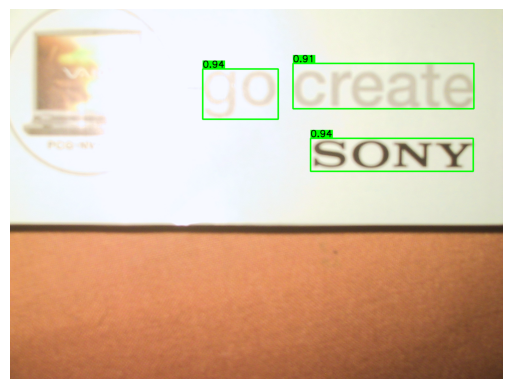

In [ ]:
model_path = 'models/yolov8/detect/train/weights/best.pt'
model = YOLO(model_path)
img_path = 'datasets/SceneTrialTrain/apanar_06.08.2002/IMG_1291.JPG'
conf_thresh = 0.75

#run inference
results = model(img_path, verbose = False)
predictions = json.loads(results[0].to_json())
visualized_img = visual_bbox(img_path, predictions, conf_thresh)

#show image
%matplotlib inline
plt.imshow(visualized_img)
plt.axis('off')
plt.show()

In [ ]:
#results o dang list objects va list do chi co 1 phan tu
print(results[0].to_json())


[
  {
    "name": "text",
    "class": 0,
    "confidence": 0.93717,
    "box": {
      "x1": 975.22205,
      "y1": 419.90179,
      "x2": 1503.17883,
      "y2": 526.82178
    }
  },
  {
    "name": "text",
    "class": 0,
    "confidence": 0.9359,
    "box": {
      "x1": 625.83716,
      "y1": 194.82272,
      "x2": 870.05615,
      "y2": 357.30545
    }
  },
  {
    "name": "text",
    "class": 0,
    "confidence": 0.90752,
    "box": {
      "x1": 918.2049,
      "y1": 176.42046,
      "x2": 1505.80859,
      "y2": 323.89389
    }
  },
  {
    "name": "text",
    "class": 0,
    "confidence": 0.46979,
    "box": {
      "x1": 168.3558,
      "y1": 176.31509,
      "x2": 329.58374,
      "y2": 228.79359
    }
  }
]


# Text Recognition

In [ ]:
import os
import shutil
import xml.etree.ElementTree as ET
import numpy as np
import pandas as pd
import random
import cv2
import timm
import matplotlib.pyplot as plt
from PIL import Image

import torch
import torch.nn as nn
import torchvision
from torch.nn import functional as F
from torchvision import models, transforms
from torch.utils.data import Dataset, DataLoader

from sklearn.model_selection import train_test_split

In [ ]:
def extract_data_from_xml(root_dir):
    xml_path = os.path.join(root_dir, 'words.xml')
    tree = ET.parse(xml_path)
    root = tree.getroot()

    img_paths = []
    img_sizes = []
    img_labels = []
    bboxes = []

    for img in root:
        bbs_of_img = []
        labels_of_img = []

        for bbs in img.findall('taggedRectangles'):
            for bb in bbs:
                #check if non-alphabet and non-number
                if not bb[0].text.isalnum():
                    continue

                if 'é' in bb[0].text.lower() or 'ñ' in bb[0].text.lower():
                    continue

                bbs_of_img.append([
                    float(bb.attrib['x']),
                    float(bb.attrib['y']),
                    float(bb.attrib['width']),
                    float(bb.attrib['height'])
                ])
                labels_of_img.append(bb[0].text.lower())

        img_paths.append(os.path.join(root_dir, img[0].text))
        img_sizes.append((int(img[1].attrib['x']), int(img[1].attrib['y'])))
        bboxes.append(bbs_of_img)
        img_labels.append(labels_of_img)

    return img_paths, img_sizes, img_labels, bboxes

In [ ]:
dataset_dir = 'datasets/SceneTrialTrain'
img_paths, img_sizes, img_labels, bboxes = extract_data_from_xml(dataset_dir)

In [ ]:
print('total image:', len(img_paths))
print('total bounding boxes:', sum([len(bb) for bb in bboxes]))

total image: 250
total bounding boxes: 1097


In [ ]:
save_dir = 'datasets/ocr_dataset'

In [ ]:
def split_bounding_boxes(img_paths, img_labels, bboxes, save_dir):
    os.makedirs(save_dir, exist_ok=True)

    count = 0
    labels = []

    for img_path, img_label, bbs in zip(img_paths, img_labels, bboxes):
        img = Image.open(img_path)

        for label, bb in zip(img_label, bbs):
            x, y, w, h = bb

            #crop image
            cropped_img = img.crop((x, y, x+w, y+h))

            #filter out of 90% of the cropped image is black or white
            if np.mean(cropped_img) < 35 or np.mean(cropped_img) > 220:
                continue

            if cropped_img.size[0] <10 or cropped_img.size[1] < 10:
                continue

            if len(img_label) < 3:# neu do dai nhan la 1 hoac 2 thi bo (trong paper)
                continue

            #save
            filename = f"{count:06d}.jpg"
            save_path = os.path.join(save_dir, filename)
            cropped_img.save(save_path)

            new_img_path = os.path.join(save_dir, filename)
            label= new_img_path + '\t' +label
            labels.append(label)
            count += 1
    print(f"created {count} images")
    with open(os.path.join(save_dir, 'labels.txt'), 'w') as f:
        for label in labels:
            f.write(label + '\n')

    #create vocabulary


In [ ]:
split_bounding_boxes(img_paths, img_labels, bboxes, save_dir)

created 964 images


#### 3. Read datasets

In [ ]:
root_dir = save_dir

img_paths = []
labels = []

with open(os.path.join(root_dir, 'labels.txt'), 'r') as f:
    for line in f:
        img_path, label = line.strip().split('\t')
        img_paths.append(img_path)
        labels.append(label)
print(f"total images: {len(img_paths)}")

total images: 964


#### 4. Prepare vocabulary

In [ ]:
letters = [char.split(".")[0].lower() for char in labels]
letters = ''.join(letters)
letters = sorted(list(set(letters)))
#create a string of all characters in dataset
chars = ''.join(letters)
#for "blank" character
blank_char = "-"
chars+= blank_char
vocab_size = len(chars)
print(f"Vocab: {chars}")
print(f"Vocab size: {vocab_size}")

Vocab: 0123456789abcdefghijklmnopqrstuvwxyz-
Vocab size: 37


### Encode/decode function

In [ ]:
char_to_idx = {char: idx+1 for idx, char in enumerate(sorted(chars))}
max_label_len = max([len(label) for label in labels])

def encode(label, char_to_idx, max_label_len):
    encoded_labels = torch.tensor(
        [char_to_idx[char] for char in label],
        dtype = torch.long
    )
    label_len = len(encoded_labels)
    lengths = torch.tensor(
        label_len,
        dtype=torch.long
    )
    padded_labels = F.pad(
        encoded_labels,
        (0, max_label_len - label_len),
        value = 0
    )
    return padded_labels, lengths


In [ ]:
idx_to_char = {idx: char for char, idx in char_to_idx.items()}
def decode(encoded_sequences, idx_to_char, blank_char = '-'):
    decoded_sequences = []
    for seq in encoded_sequences:
        decoded_label = []
        for idx, token in enumerate(seq):
            if token != 0:
                char = idx_to_char[token.item()]
                if char != blank_char:
                    decoded_label.append(char)

        decoded_sequences.append(''.join(decoded_label))
    return decoded_sequences

In [ ]:
input_str = 'hello'
input_encoded, input_len = encode(input_str, char_to_idx, max_label_len)
print(input_encoded)
print(input_len)

tensor([19, 16, 23, 23, 26,  0,  0,  0,  0,  0,  0,  0,  0,  0])
tensor(5)


In [ ]:
input_decoded = decode(input_encoded.unsqueeze(0), idx_to_char)
print(input_decoded)

['hello']


#### Create data preprocessing function and augmentation

In [ ]:
data_transforms = {
    'train': transforms.Compose([
    transforms.Resize((100, 420)),
    transforms.ColorJitter(
        brightness=0.4,
        contrast=0.4,
        saturation=0.4,
    ),
    transforms.Grayscale(num_output_channels=1),
    transforms.GaussianBlur(3),
    transforms.RandomAffine(degrees = 1, shear = 1),
    transforms.RandomPerspective(
        distortion_scale=0.5,
        p=0.5,
        interpolation=3
    ),
    transforms.RandomRotation(degrees = 2.5),
    transforms.ToTensor(),
    transforms.Normalize(
        mean = [0.5],
        std = [0.5]
    )
]),
    'val': transforms.Compose([
    transforms.Resize((100, 420)),
    transforms.Grayscale(num_output_channels=1),
    transforms.ToTensor(),
    transforms.Normalize(
        mean = [0.5],
        std = [0.5]
    )
])
}


#### 6. Train, val, test, split

In [ ]:
seed = 0
val_size = 0.2
test_size = 0.125
is_shuffle = True
X_train, X_val, y_train, y_val = train_test_split(
    img_paths, labels,
    test_size = val_size,
    random_state = seed,
    shuffle = is_shuffle
)
X_train, X_test, y_train, y_test = train_test_split(
    X_train, y_train,
    test_size = test_size,
    random_state = seed,
    shuffle = is_shuffle
)

#### 7.Create Pytorch datasets

In [ ]:
class STRDataset(Dataset):
    def __init__(
            self,
            X, y,
            char_to_idx,
            max_label_len,
            label_encoder = None,
            transform = None
    ):
        self.transform = transform
        self.img_paths = X
        self.labels = y
        self.char_to_idx = char_to_idx
        self.max_label_len = max_label_len
        self.label_encoder = label_encoder

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        label = self.labels[idx]
        img_path = self.img_paths[idx]
        img = Image.open(img_path).convert('RGB')

        if self.transform:
            img = self.transform(img)

        if self.label_encoder:
            encoded_label, label_len = self.label_encoder(
                label,
                self.char_to_idx,
                self.max_label_len
            )
        return img, encoded_label, label_len

#### 8. Create dalaloader

In [ ]:
train_dataset = STRDataset(
    X_train, y_train,
    char_to_idx,
    max_label_len,
    encode,
    data_transforms['train']
)

val_dataset = STRDataset(
    X_val, y_val,
    char_to_idx,
    max_label_len,
    encode,
    data_transforms['val']
)
test_dataset = STRDataset(
    X_test, y_test,
    char_to_idx,
    max_label_len,
    encode,
    data_transforms['val']
)

In [ ]:
print(f"train: {len(train_dataset)}")
print(f"val: {len(val_dataset)}")
print(f"test: {len(test_dataset)}")

train: 674
val: 193
test: 97


In [ ]:
train_batch_size = 32
test_batch_size = 8

train_loader = DataLoader(
    train_dataset,
    batch_size = train_batch_size,
    shuffle = True
)

val_loader = DataLoader(
    val_dataset,
    batch_size = test_batch_size,
    shuffle = False
)

test_loader = DataLoader(
    test_dataset,
    batch_size = test_batch_size,
    shuffle = False
)


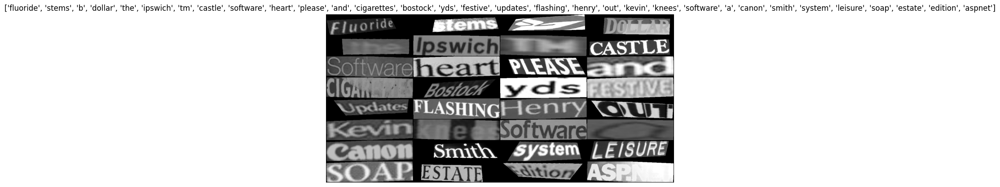

In [ ]:
train_features, train_labels, train_lengths = next(iter(train_loader))

#use torchvision to display a grid of images
def show_batch(imgs, labels):
    labels = decode(labels, idx_to_char)
    grid = torchvision.utils.make_grid(imgs, nrow = 4, normalize = True)
    plt.figure(figsize = (10,20))
    plt.imshow(np.transpose(grid, (1,2,0)))
    plt.title(labels)
    plt.axis('off')
    plt.show()

show_batch(train_features, train_labels)

#### 9. Create model

In [ ]:
class CRNN(nn.Module):
    def __init__(
            self,
            vocab_size,
            hidden_size,
            n_layers,
            dropout = 0.2,
            unfreeze_layers = 3
    ):
        super(CRNN, self).__init__()
        backbone = timm.create_model( #timm chua cac pretrained model
            'resnet101',
            in_chans =1,
            pretrained = True
        )
        modules = list(backbone.children())[:-2] #children la cac layer cua resnet101
        #bo di 2 layer cuoi la maxpool va fc vi minh muon lay phan feature extraction
        modules.append(nn.AdaptiveAvgPool2d((1, None)))
        self.backbone = nn.Sequential(*modules)

        #Unfreeze the last few layers de cap nhat trong so cua layers do
        for parameter in self.backbone[-unfreeze_layers:].parameters():
            parameter.requires_grad = True
        self.mapSeq = nn.Sequential(
            nn.Linear(2048, 512),
            nn.ReLU(),
            nn.Dropout(dropout)
        )

        self.lstm = nn.LSTM(
            512, hidden_size,
            n_layers, bidirectional = True,
            batch_first = True,
            dropout = dropout if n_layers > 1 else 0
        )

        self.layer_norm = nn.LayerNorm(hidden_size * 2)
        self.out = nn.Sequential(
            nn.Linear(hidden_size * 2, vocab_size),
            nn.LogSoftmax(dim = 2)
        )
    def forward(self, x):
        print(x.shape) #input
        x = self.backbone(x)
        print(x.shape)
        x = x.permute(0, 3, 1, 2)
        print(x.shape)
        x = x.view(x.size(0), x.size(1), -1)
        print(x.shape)
        x = self.mapSeq(x)
        print(x.shape)
        x, _ = self.lstm(x)
        print(x.shape)
        x = self.layer_norm(x)
        print(x.shape)
        x = self.out(x)
        print(x.shape)
        x = x.permute(1, 0, 2)
        return x

In [ ]:
hidden_size = 256
n_layers = 3
dropout = 0.2
unfreeze_layers = 3
device = 'cuda' if torch.cuda.is_available() else 'cpu'

model = CRNN(
    vocab_size,
    hidden_size,
    n_layers,
    dropout,
    unfreeze_layers
).to(device)

In [ ]:
model.eval()
dummy_tensor = torch.randn((64, 1, 32, 100)).to(device)
with torch.no_grad():
    out = model(dummy_tensor)
print(out.shape)

torch.Size([64, 1, 32, 100])
torch.Size([64, 2048, 1, 4])
torch.Size([64, 4, 2048, 1])
torch.Size([64, 4, 2048])
torch.Size([64, 4, 512])
torch.Size([64, 4, 512])
torch.Size([64, 4, 512])
torch.Size([64, 4, 37])
torch.Size([4, 64, 37])


#### 10. Training

In [ ]:
def evaluate(model, dataloader, criterion, device):
    model.eval()
    losses = []
    with torch.no_grad():
        for inputs, labels, labels_len in dataloader:
            inputs = inputs.to(device)
            labels = labels.to(device)
            labels_len = labels_len.to(device)

            outputs = model(inputs)
            logits_lens = torch.full(
                size = (outputs.size(1),),
                fill_value = outputs.size(0),
                dtype = torch.long
            ).to(device)

            loss = criterion(
                outputs,
                labels,
                logits_lens,
                labels_len
            )

            losses.append(loss.item())
    loss = sum(losses)/len(losses)
    return loss

In [ ]:
def fit(
        model,
        train_loader,
        val_loader,
        criterion,
        optimizer,
        scheduler,
        device,
        epochs
):
    train_losses = []
    val_losses = []
    for epoch in range(epochs):
        batch_train_losses = []

        model.train()
        for idx, (inputs, labels, labels_len) in enumerate(train_loader):
            inputs = inputs.to(device)
            labels = labels.to(device)
            labels_len = labels_len.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)

            logits_lens = torch.full(
                size = (outputs.size(1),),
                fill_value = outputs.size(0),
                dtype = torch.long
            ).to(device)

            loss = criterion(
                outputs,
                labels,
                logits_lens,
                labels_len
            )

            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 5)
            optimizer.step()

            batch_train_losses.append(loss.item())

        train_loss = sum(batch_train_losses)/len(batch_train_losses)
        train_losses.append(train_loss)

        val_loss = evaluate(model, val_loader, criterion, device)
        val_losses.append(val_loss)

        print(f'EPOCH {epoch +1}: train_loss: {train_loss:.4f}, val_loss: {val_loss:.4f}')
        scheduler.step(val_loss)
    return train_losses, val_losses

In [ ]:
epochs = 100
lr = 0.001
weight_decay =  1e-5
scheduler_step_size = epochs *0.4

criterion = nn.CTCLoss(
    blank = char_to_idx[blank_char],
    zero_infinity = True
)

optimizer = torch.optim.Adam(
    model.parameters(),
    lr = lr,
    weight_decay = weight_decay
)

scheduler = torch.optim.lr_scheduler.StepLR(
    optimizer,
    step_size = scheduler_step_size,
    gamma = 0.1
)



In [ ]:
train_losses, val_losses = fit(
    model,
    train_loader,
    val_loader,
    criterion,
    optimizer,
    scheduler,
    device,
    epochs
)

torch.Size([32, 1, 100, 420])
torch.Size([32, 2048, 1, 14])
torch.Size([32, 14, 2048, 1])
torch.Size([32, 14, 2048])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 37])


/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: ctc_loss_backward_gpu does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: adaptive_avg_pool2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backwa

torch.Size([32, 1, 100, 420])
torch.Size([32, 2048, 1, 14])
torch.Size([32, 14, 2048, 1])
torch.Size([32, 14, 2048])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 37])
torch.Size([32, 1, 100, 420])
torch.Size([32, 2048, 1, 14])
torch.Size([32, 14, 2048, 1])
torch.Size([32, 14, 2048])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 37])
torch.Size([32, 1, 100, 420])
torch.Size([32, 2048, 1, 14])
torch.Size([32, 14, 2048, 1])
torch.Size([32, 14, 2048])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 37])
torch.Size([32, 1, 100, 420])
torch.Size([32, 2048, 1, 14])
torch.Size([32, 14, 2048, 1])
torch.Size([32, 14, 2048])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 512])
torch.Size([32, 14, 37])
torch.Size([32, 1, 100, 420])
torch.Size([32, 2048, 1, 14])
torch.Size([32, 14, 2048, 1])
torch.Size([32, 14, 2048])
tor

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:240: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


Streaming output truncated to the last 5000 lines.
torch.Size([8, 14, 512])
torch.Size([8, 14, 37])
torch.Size([8, 1, 100, 420])
torch.Size([8, 2048, 1, 14])
torch.Size([8, 14, 2048, 1])
torch.Size([8, 14, 2048])
torch.Size([8, 14, 512])
torch.Size([8, 14, 512])
torch.Size([8, 14, 512])
torch.Size([8, 14, 37])
torch.Size([8, 1, 100, 420])
torch.Size([8, 2048, 1, 14])
torch.Size([8, 14, 2048, 1])
torch.Size([8, 14, 2048])
torch.Size([8, 14, 512])
torch.Size([8, 14, 512])
torch.Size([8, 14, 512])
torch.Size([8, 14, 37])
torch.Size([8, 1, 100, 420])
torch.Size([8, 2048, 1, 14])
torch.Size([8, 14, 2048, 1])
torch.Size([8, 14, 2048])
torch.Size([8, 14, 512])
torch.Size([8, 14, 512])
torch.Size([8, 14, 512])
torch.Size([8, 14, 37])
torch.Size([8, 1, 100, 420])
torch.Size([8, 2048, 1, 14])
torch.Size([8, 14, 2048, 1])
torch.Size([8, 14, 2048])
torch.Size([8, 14, 512])
torch.Size([8, 14, 512])
torch.Size([8, 14, 512])
torch.Size([8, 14, 37])
torch.Size([8, 1, 100, 420])
torch.Size([8, 2048, 1,

In [ ]:
val_loss = evaluate(
    model,
    val_loader,
    criterion,
    device
)

test_loss = evaluate(
    model,
    test_loader,
    criterion,
    device
)

print('Evaluation: ')
print('Val loss: ', val_loss)
print('Test loss: ', test_loss)

In [ ]:
save_model_path = 'models/ocr_crnn_base_best.pt'
torch.save(
    model.state_dict(),
    save_model_path
)

End-to-End Pipeline

In [ ]:
def text_detection(img_path, text_det_model):
    text_det_results = text_det_model(img_path, verbose = False)[0]

    bboxes = text_det_results.boxes.xyxy.tolist()
    classes = text_det_results.boxes.cls.tolist()
    names = text_det_results.names
    scores = text_det_results.boxes.conf.tolist()

    return bboxes, classes,names, scores

def text_recognition(img, data_transforms, text_reg_model, idx_to_char, device):
    transformed_img = data_transforms(img)
    transformed_img = transformed_img.unsqueeze(0)
    transformed_img = transformed_img.to(device)
    text_reg_model.eval()

    with torch.no_grad():
        logits = text_reg_model(transformed_img).detach().cpu()
    text = decode(logits.permute(1, 0, 2).argmax(2), idx_to_char)

    return text

def visualize_detections(img, detections):
    plt.figure(figsize = (10, 10))
    plt.imshow(img)
    plt.axis('off')

    for bbox, detected_class, confidence, transcribed_text in detections:
        x1, y1, x2, y2 = bbox
        plt.gca().add_patch(
            plt.Rectangle(
                (x1, y1),
                x2 - x1,
                y2 - y1,
                fill = False,
                edgecolor = 'red',
                linewidth = 2)
            )
        plt.text(
            x1, y1-10, f"{detected_class}: {confidence:.2f}\n{transcribed_text}",
            color = 'white',
            bbox = dict(facecolor = 'red', alpha = 0.5)
        )

    plt.show()

def predict(img_path, data_transforms, text_det_model, text_reg_model, idx_to_char, device):
    bboxes, classes, names, confs = text_detection(img_path, text_det_model)

    img = Image.open(img_path)

    predictions = []

    for bbox, cls, conf in zip(bboxes, classes, confs):
        x1, y1, x2, y2 = bbox
        confidence = conf
        detected_class = cls
        name = names[int(cls)]

        cropped_img = img.crop((x1, y1, x2, y2))

        transcribed_text = text_recognition(
            cropped_img,
            data_transforms,
            text_reg_model,
            idx_to_char,
            device
        )
        print(transcribed_text)
        reduce_text = [remove_repeated_chars(text) for text in transcribed_text]
        print(reduce_text)
        fix_text = [spell.correction(word) for word in reduce_text]

        if (fix_text) != [None]:
            predictions.append(
            (bbox, name, confidence, fix_text)
        )
        else:
            predictions.append(
            (bbox, name, confidence, transcribed_text)
        )

    visualize_detections(img, predictions)
    return predictions

In [ ]:
li = [None]
print(li != [None])

False


In [ ]:
from spellchecker import SpellChecker
spell = SpellChecker()

text = "aal deenttal ssuurgery"

words = text.split()
corrected_words = [spell.correction(word) for word in words]
corrected_text = ' '.join(corrected_words)
print(corrected_text)


all dental surgery


In [ ]:
yolo = YOLO('models/yolov8/detect/train/weights/best.pt')

hidden_size = 256
n_layers = 3
dropout = 0.2
unfreeze_layers = 3
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model_path = 'models/ocr_crnn_base_best.pt'

crnn_model = CRNN(
    vocab_size,
    hidden_size,
    n_layers,
    dropout,
    unfreeze_layers
).to(device)
crnn_model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))

<All keys matched successfully>

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['teetthh']
['teth']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['bewaree']
['beware']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['aalllgaator']
['algator']


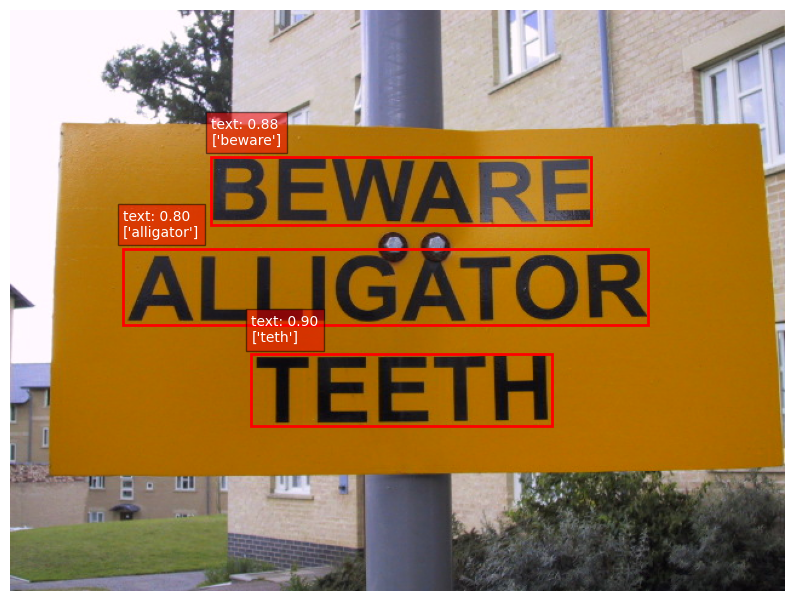

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['hheight']
['height']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['1115mm']
['15m']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['whheen']
['when']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['wiitth']
['with']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([

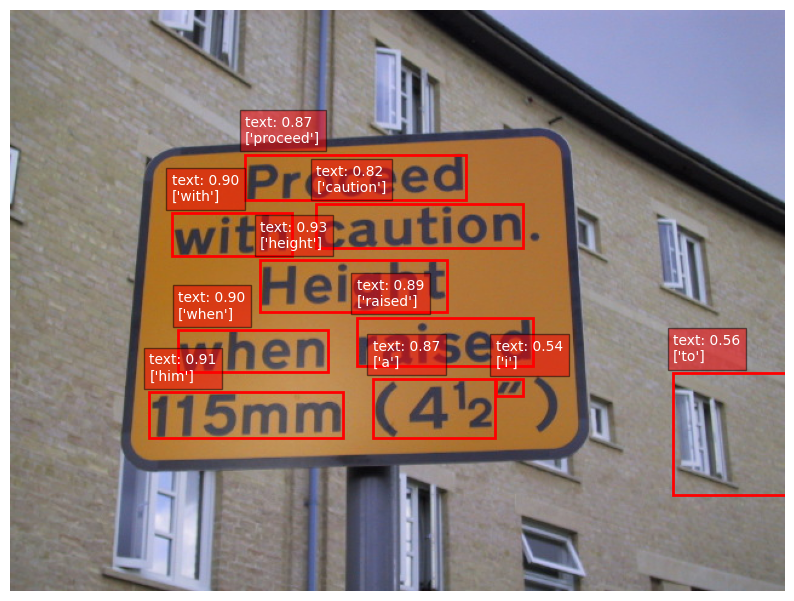

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['lllimmiitedd']
['limited']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['coossrucciion']
['cosrucion']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['coonstroction']
['constroction']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['refurbishmment']
['refurbishment']
torch.Size([1, 1, 1

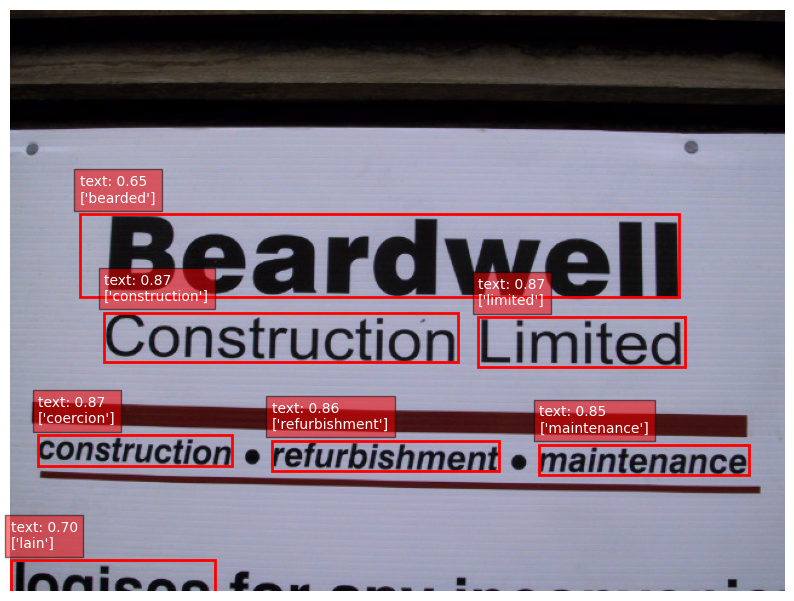

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['hl']
['hl']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['ouuckh']
['ouckh']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['uuuchl']
['uchl']


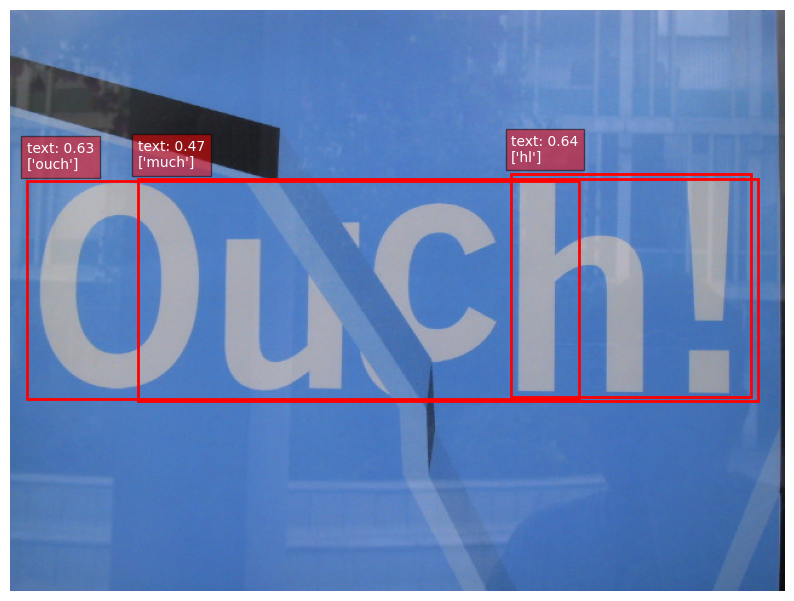

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['rroad']
['road']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['bboundaryy']
['boundary']


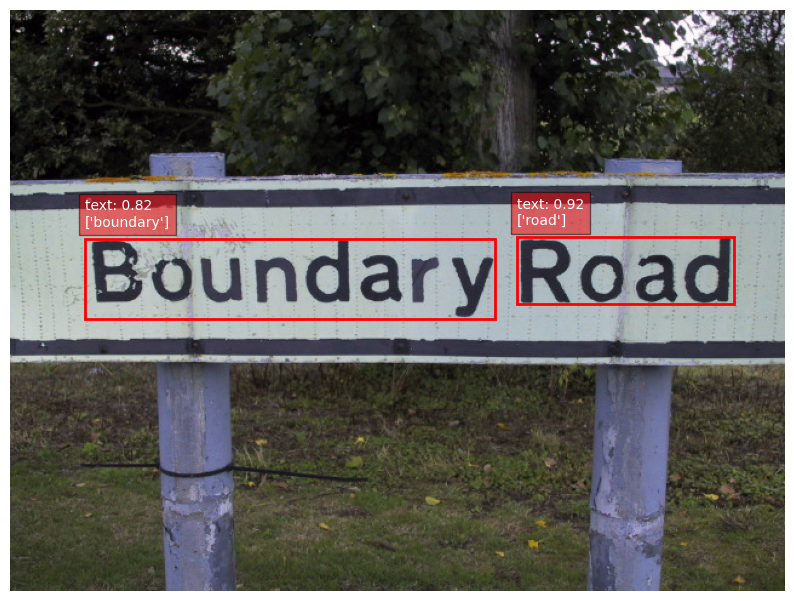

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['dd']
['d']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['top']
['top']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['']
['']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['o']
['o']


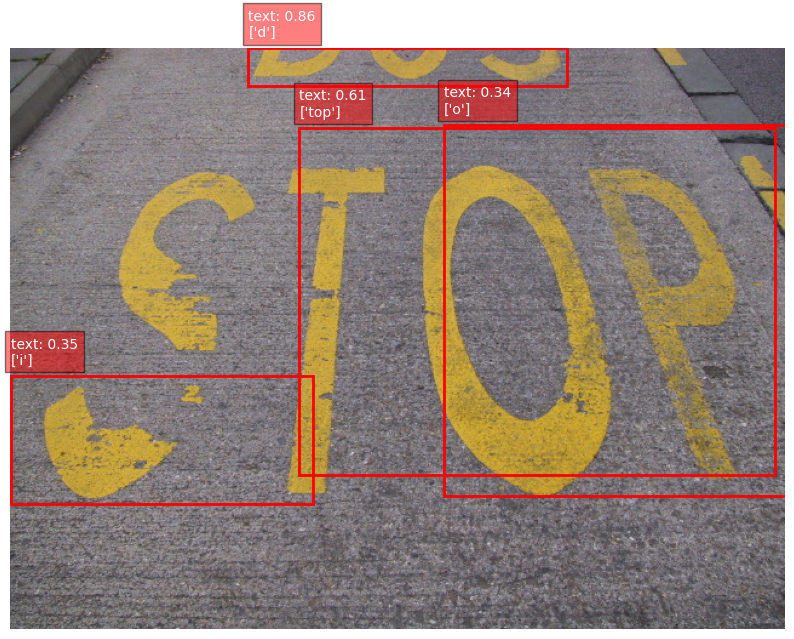

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['tuuseeuumm']
['tuseum']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['ccllockk']
['clock']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['tympeerleyt']
['tymperleyt']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['mmpeerleyss']
['mperleys']


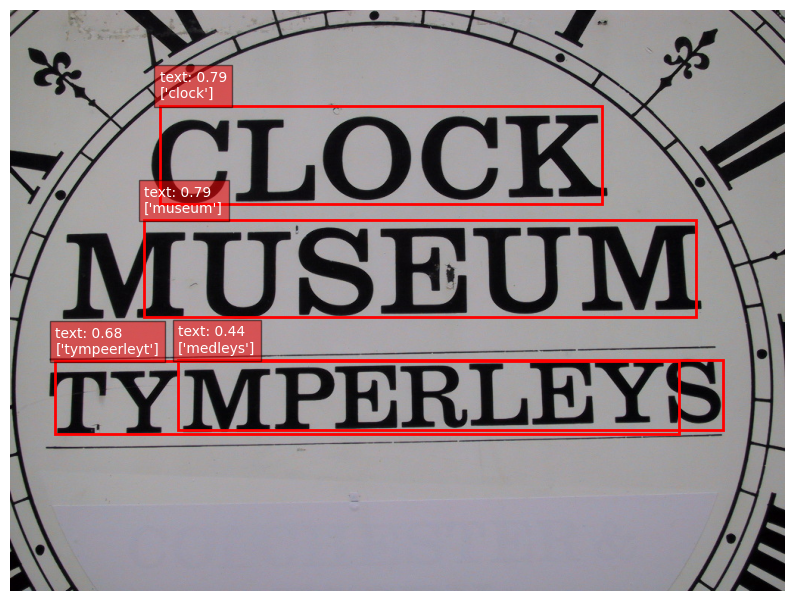

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['eesseex']
['esex']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['coouuncil']
['council']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['llibrarieess']
['libraries']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['couunty']
['county']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1

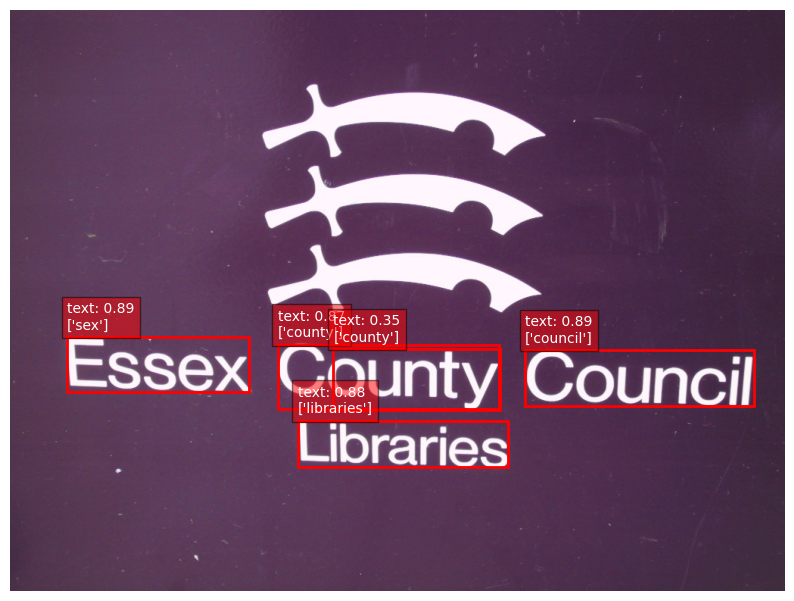

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['ccaarr']
['car']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['to']
['to']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['mmaarkks']
['marks']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['byy']
['by']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048

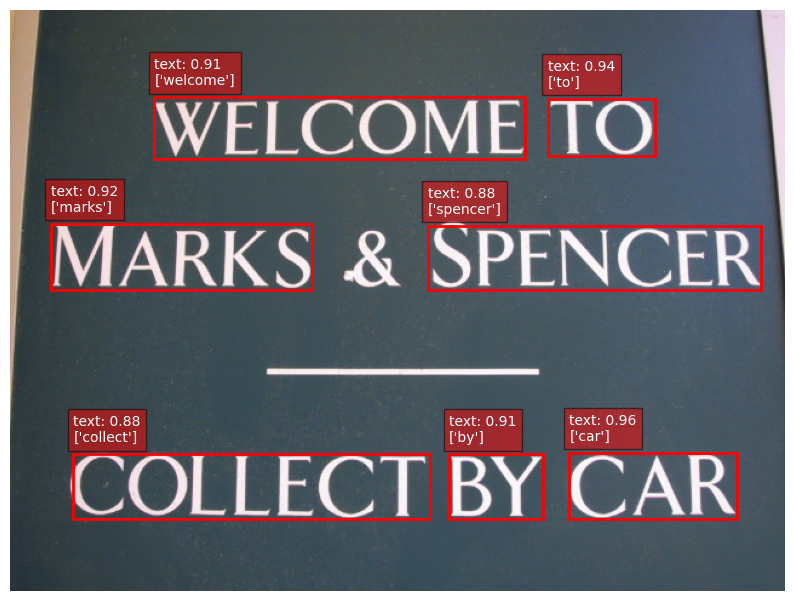

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['ww']
['w']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['h']
['h']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['ssmiithhh']
['smith']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['swmmeer']
['swmer']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048

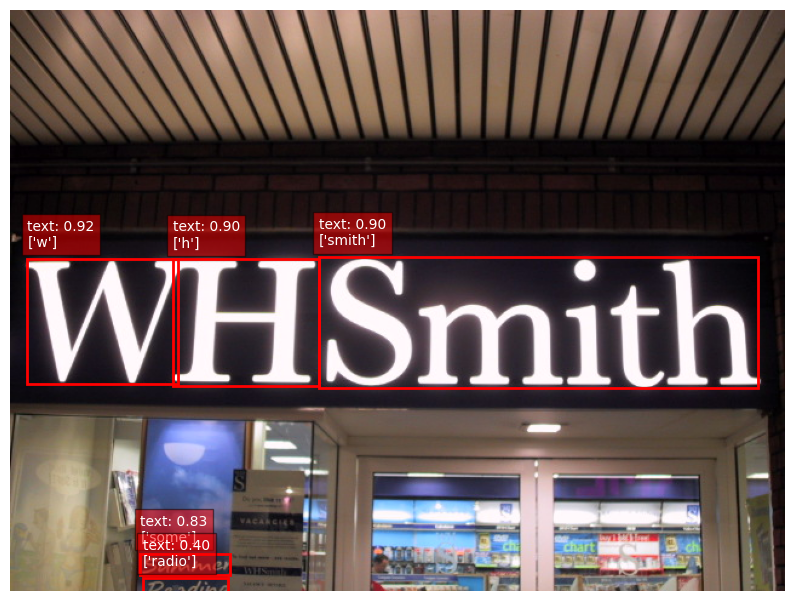

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['rred']
['red']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['sshops']
['shops']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['llion']
['lion']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['high']
['high']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 

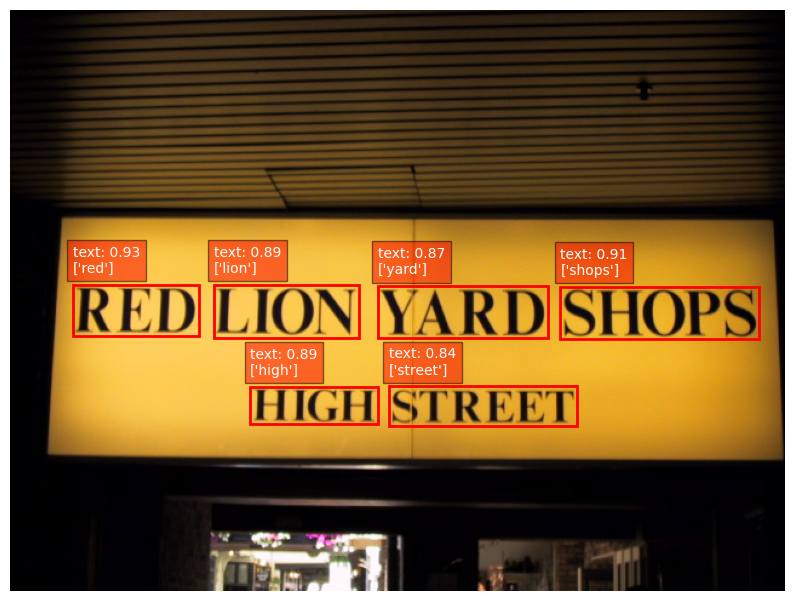

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['thhhhe']
['the']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['weaather']
['weather']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['suummee']
['sume']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['wwihateverrthh']
['wihateverth']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1,

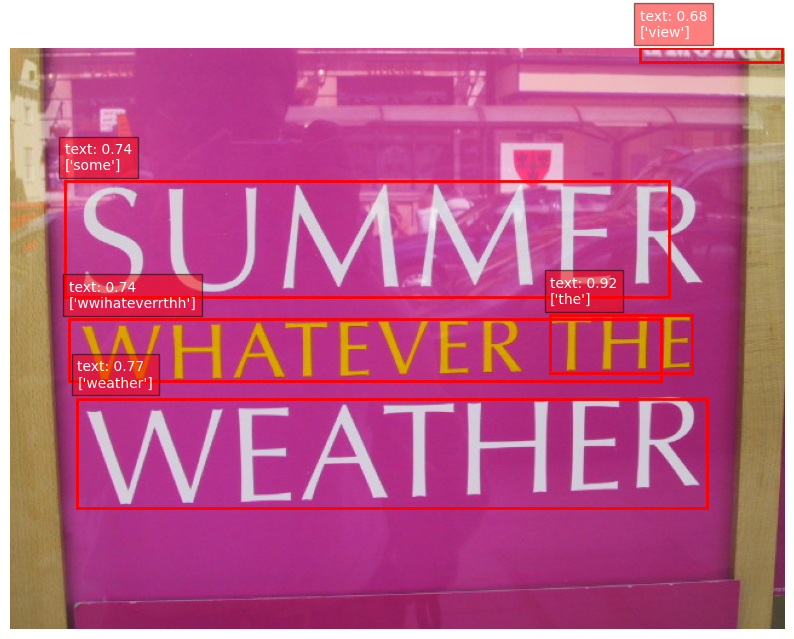

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['rvaa']
['rva']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['hheree']
['here']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['tm']
['tm']


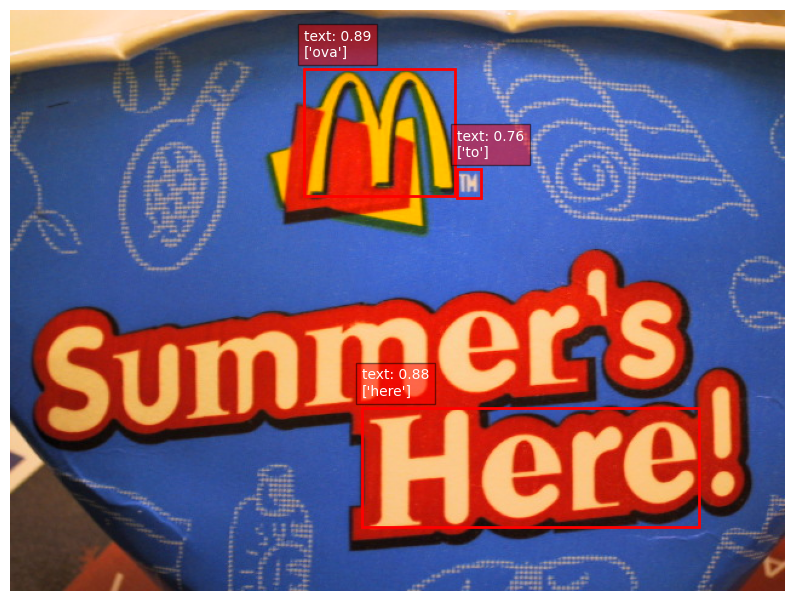

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['guuiide']
['guide']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['keennneddy']
['kenedy']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['roouugh']
['rough']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['aangguuus']
['angus']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])


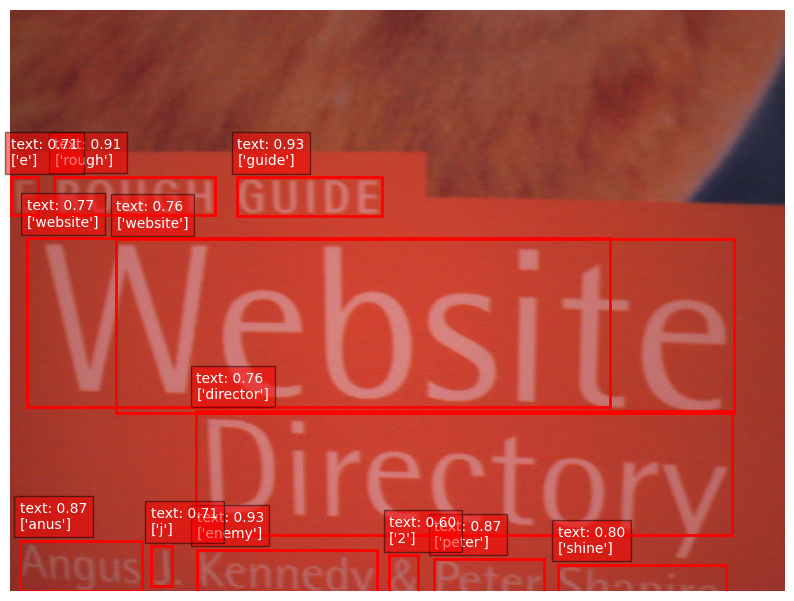

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['sscoap']
['scoap']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['hheenry']
['henry']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['bbeeqquueet']
['bequet']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['jjavaa']
['java']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torc

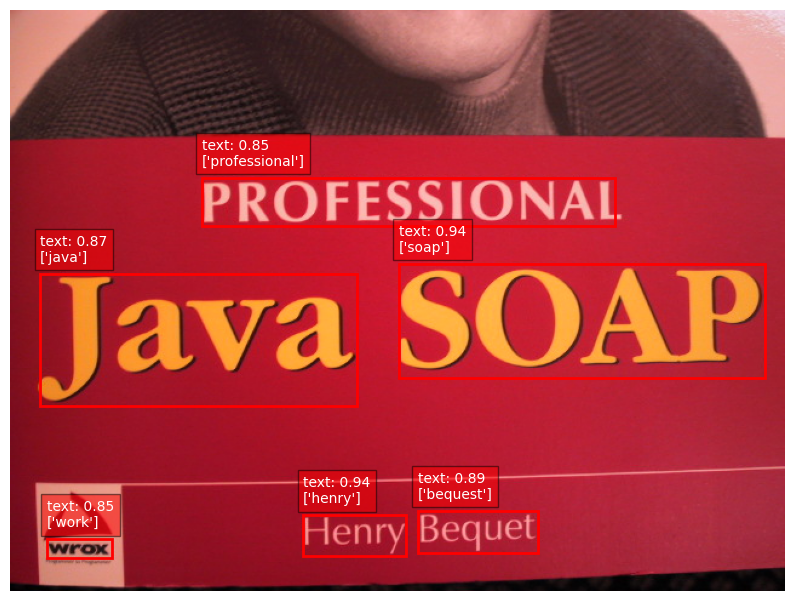

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['guuuy']
['guy']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['guuuiddee']
['guide']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['b']
['b']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['sstteele']
['stele']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14

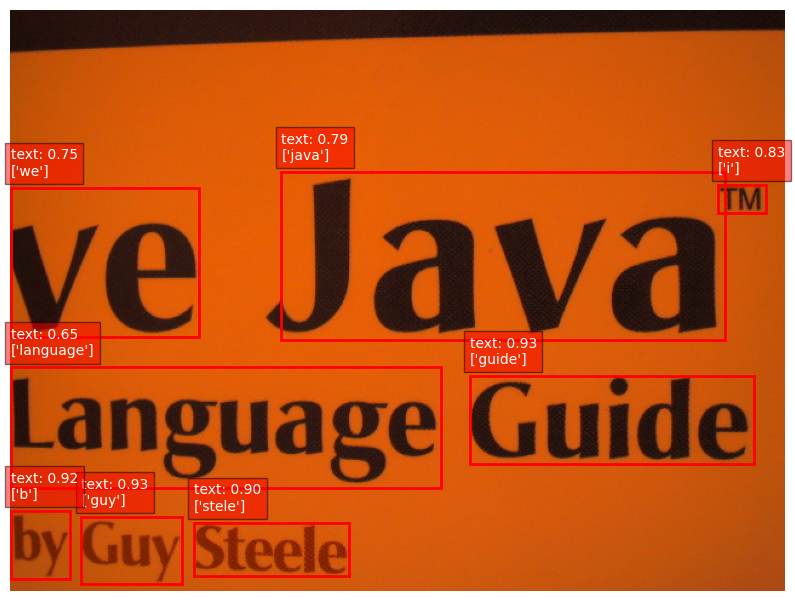

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['forrm']
['form']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['lidda']
['lida']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['jjj2sse']
['j2se']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['j22ssee']
['j2se']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1,

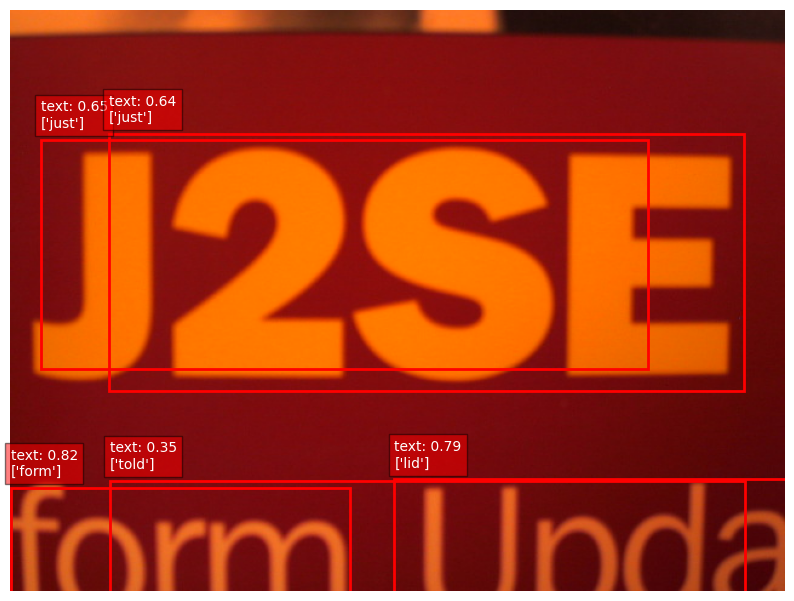

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['ooffiicce']
['ofice']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['posstt']
['post']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['colchhesterr']
['colchester']


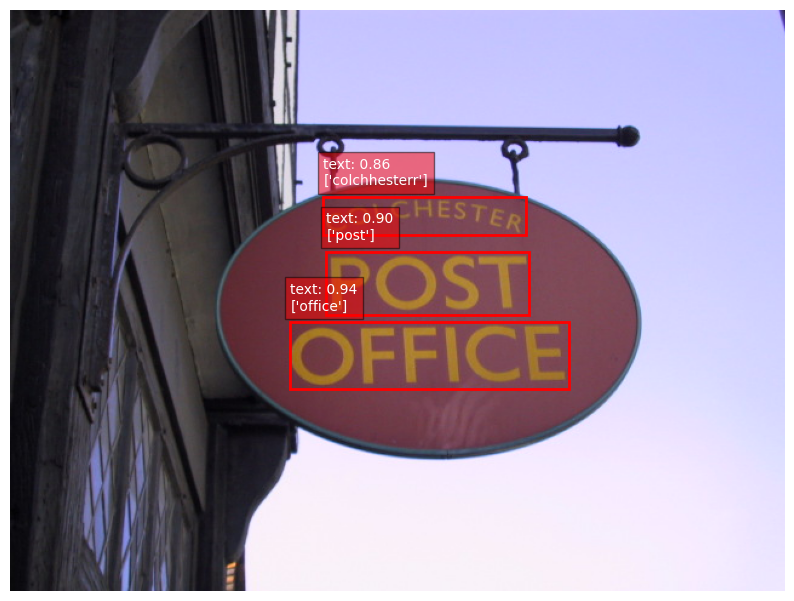

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['beeerr']
['ber']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['caarrden']
['carden']


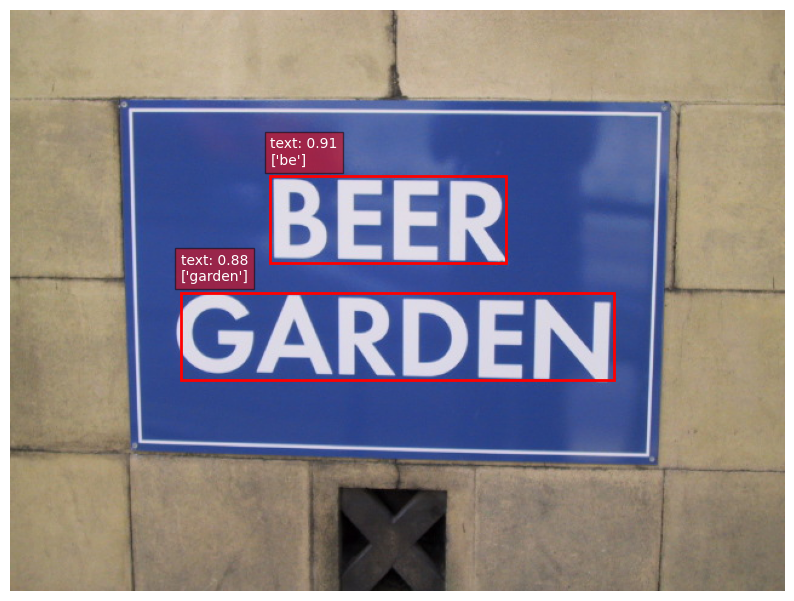

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['lockk']
['lock']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['tthhhee']
['the']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['gattee']
['gate']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['ppllease']
['please']


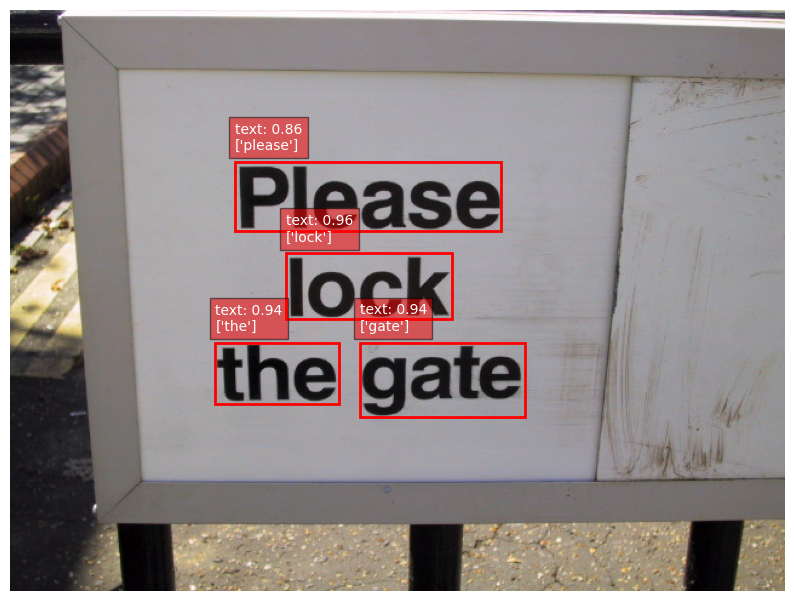

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['rottel']
['rotel']


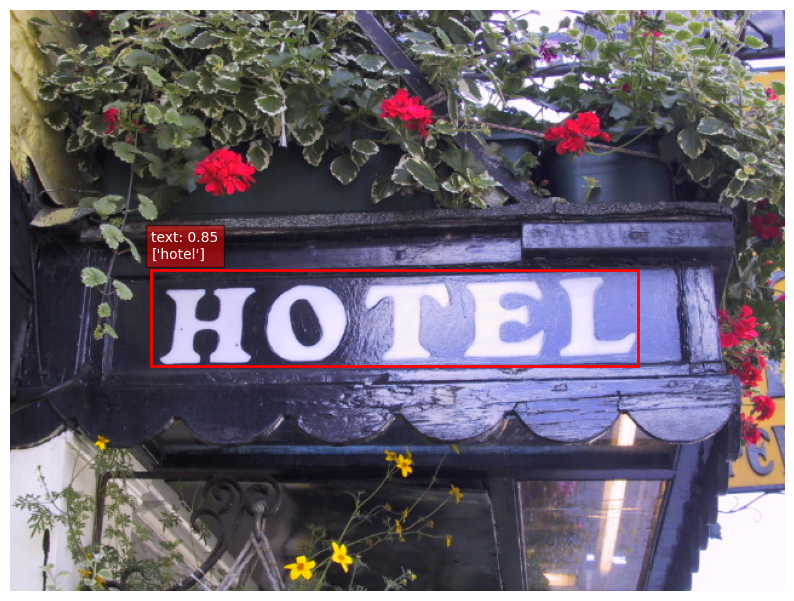

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['deenttal']
['dental']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['ssuurgery']
['surgery']


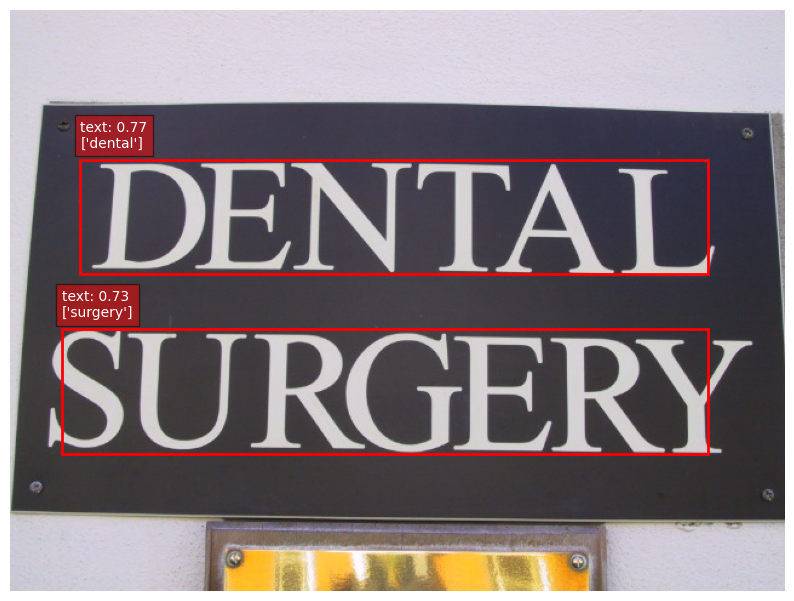

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['hoolssten']
['holsten']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['laer']
['laer']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['pure']
['pure']


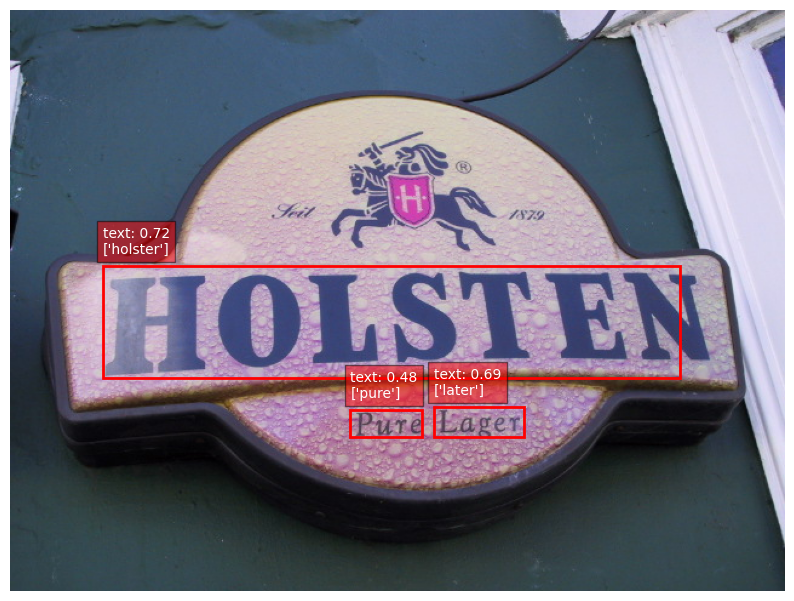

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['carree']
['care']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['foosteerr']
['foster']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['aassociiatess']
['asociates']


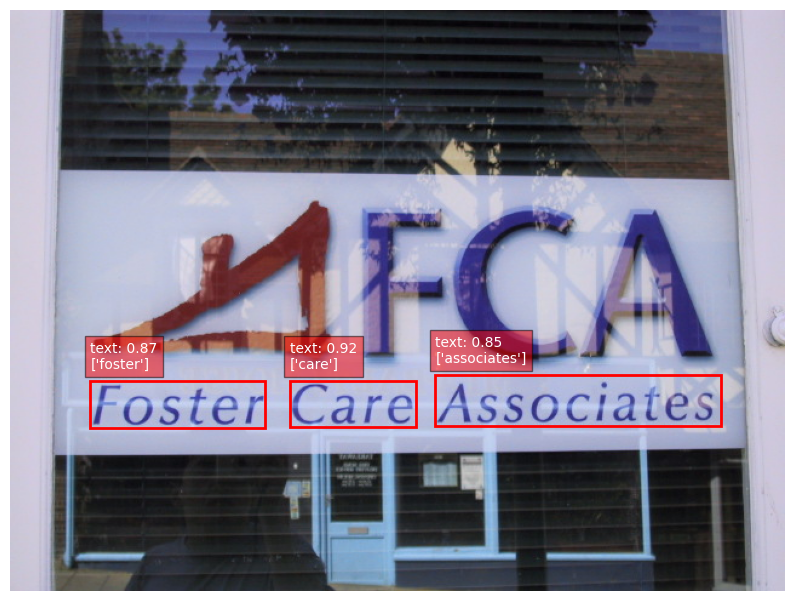

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['mdleborouug']
['mdleboroug']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['ddileboroouchh']
['dileborouch']


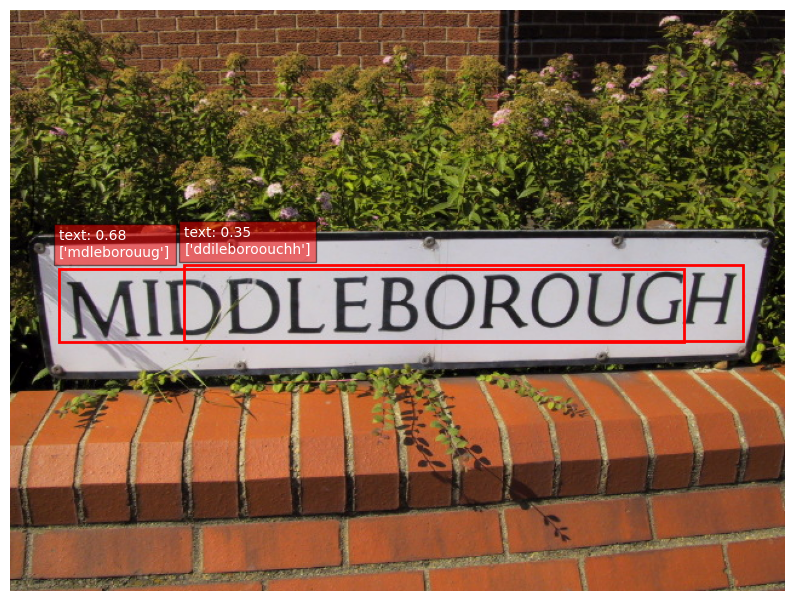

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['copecn']
['copecn']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['tihhec']
['tihec']


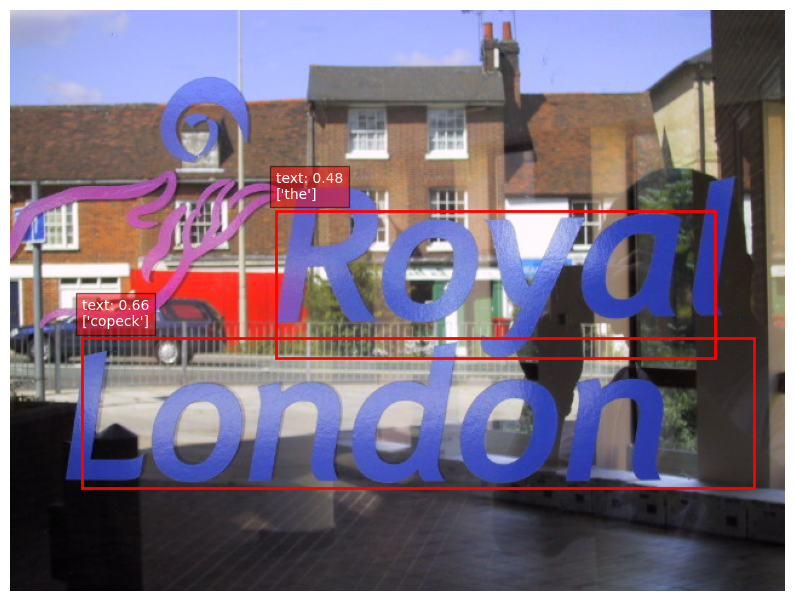

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['nhhss']
['nhs']


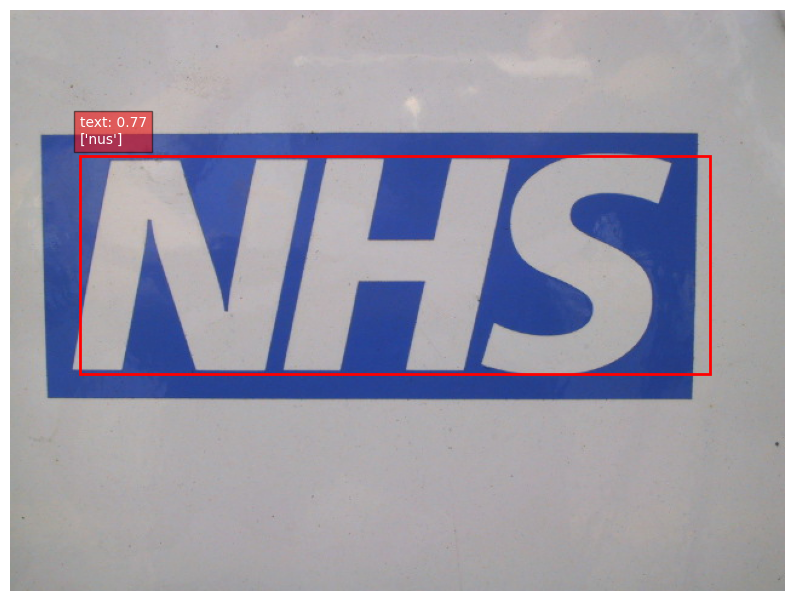

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['commeel']
['comel']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['onnelss']
['onels']


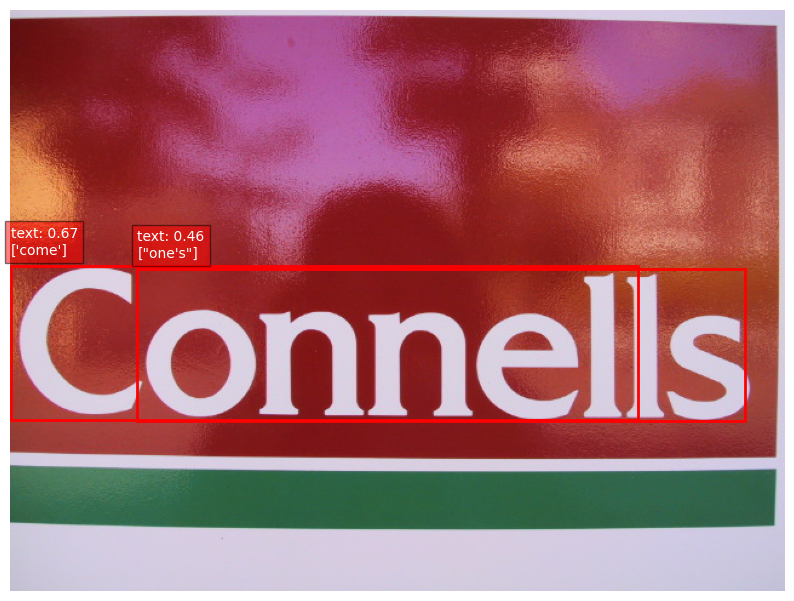

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['thhheee']
['the']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['baankk']
['bank']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['hhssbc']
['hsbc']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['worridss']
['worids']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size

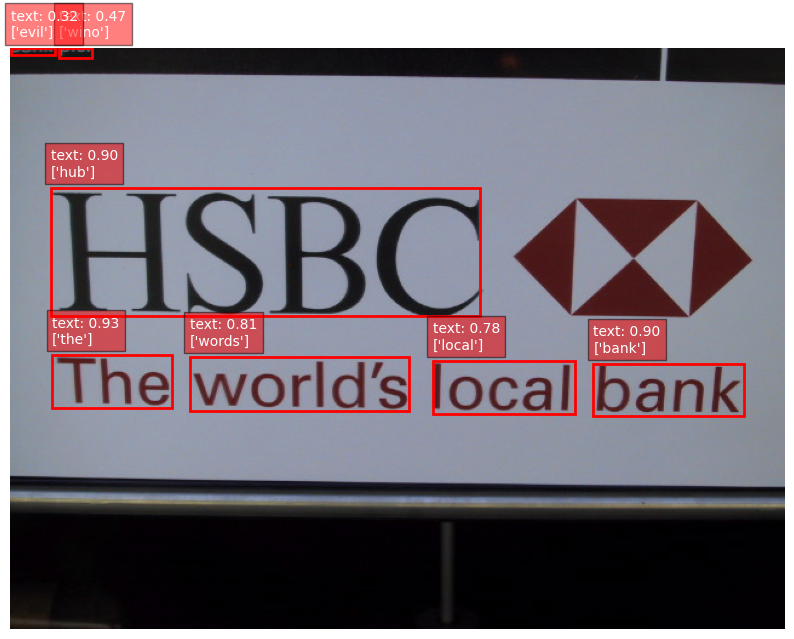

torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['rreegiisteredd']
['registered']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['seaatraade']
['seatrade']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['seaatraade']
['seatrade']
torch.Size([1, 1, 100, 420])
torch.Size([1, 2048, 1, 14])
torch.Size([1, 14, 2048, 1])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 512])
torch.Size([1, 14, 37])
['hhouuse']
['house']
torch.Size([1, 1, 100, 420])
torch.Size(

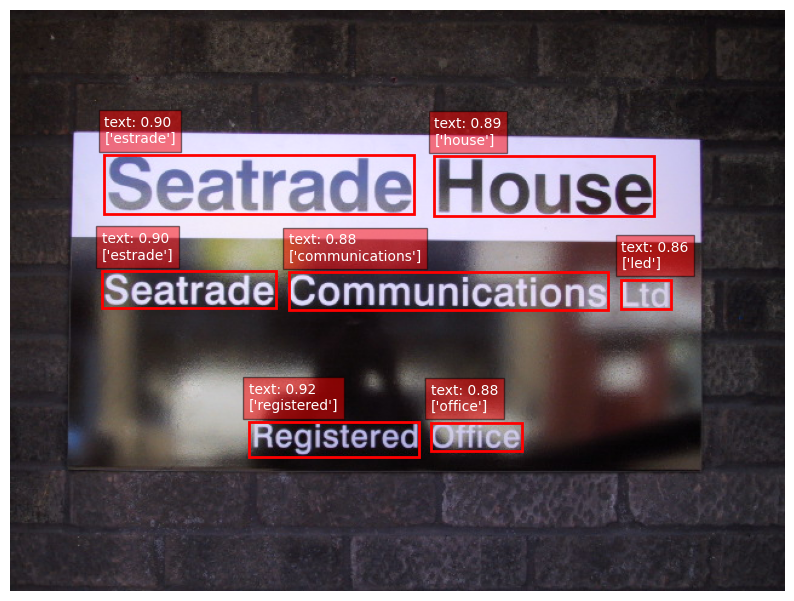

In [ ]:
img_dir = 'datasets/SceneTrialTrain/lfsosa_12.08.2002'
inf_transforms = data_transforms['val']

for img_filename in os.listdir(img_dir)[:30]:
    img_path = os.path.join(img_dir, img_filename)
    predictions = predict(
        img_path,
        data_transforms = inf_transforms,
        text_det_model = yolo,
        text_reg_model = crnn_model,
        idx_to_char = idx_to_char,
        device = device
    )

In [ ]:
import re

def remove_repeated_chars(text):
    text = re.sub(r'(.)\1+', r'\1', text)

    return text

text = 'synccc taxxt all'
print(remove_repeated_chars(text))

sync taxt al


In [ ]:
# import re
# import spacy

# nlp = spacy.load('en_core_web_sm')

# def remove_repeated_chars(text):
#     text = re.sub(r'(.)\1{2,}', r'\1\1', text)
#     return text

# text = "synccc taxxt all"
# doc = nlp(text)
# corrected_text = ' '.join(remove_repeated_chars(token.text) for token in doc)
# print(corrected_text)

syncc taxxt all


In [ ]:
from spellchecker import SpellChecker
spell = SpellChecker(language = 'en')

text = "aall denttal sugery"

words = text.split()
corrected_words = [spell.correction(word) for word in words]
corrected_text = ' '.join(corrected_words)
print(corrected_text)



all dental surgery


In [ ]:
!pip install pyspellchecker

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 45.3 MB/s eta 0:00:00
